In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from photometric_stereo.psvizualization import plotar_mapa_altura_3d, plotar_canais, plotar_canais_3d

# Função para carregar imagens e fontes de luz
def load_images_and_light_sources(image_paths, light_sources):
    images = []
    for path in image_paths:
        img = cv2.imread(path, cv2.IMREAD_GRAYSCALE)
        if img is None:
            raise ValueError(f"Erro ao carregar a imagem: {path}")
        images.append(img.astype(np.float32) / 255.0)
    return np.stack(images, axis=-1), np.array(light_sources)

# Função para estimar as normais da superfície
def estimate_normals(images, light_sources):
    images = images + 1e-6  # Adiciona um pequeno valor para evitar divisão por zero
    h, w, num_images = images.shape
    images = images.reshape(-1, num_images)

    # Resolver o sistema linear I = L * N
    normals = np.linalg.lstsq(light_sources, images.T, rcond=None)[0]

    # Normalizar as normais
    normals /= np.linalg.norm(normals, axis=0)
    normals = normals.T.reshape(h, w, 3)
    return normals

# Função para visualizar as normais
def visualize_normals(normals):
    normals_visual = (normals + 1) / 2  # Mapeia valores de [-1, 1] para [0, 1]
    plt.imshow(normals_visual)
    plt.axis('off')
    plt.title("Normais da Superfície")
    plt.show()

In [2]:
import os

def listar_arquivos(caminho_pasta):
    """
    Retorna uma lista com os caminhos completos de todos os arquivos em uma pasta.

    Args:
        caminho_pasta (str): O caminho da pasta.

    Returns:
        list: Lista com os caminhos completos dos arquivos.
    """
    caminhos_arquivos = []
    for root, _, files in os.walk(caminho_pasta):
        for file in files:
            caminhos_arquivos.append(os.path.join(root, file))
    caminhos_arquivos.sort()
    return caminhos_arquivos



In [4]:
path = '/home/lelis/Documents/Projetos/hybrid-stereo-method/data/raw/photometric_stereo/ex19_povball-txF/images/'
image_paths = listar_arquivos(path)

light_path = '/home/lelis/Documents/Projetos/hybrid-stereo-method/data/raw/photometric_stereo/ex19_povball-txF/lights.npy'
light_sources = np.load(light_path)


mask_path = '/home/lelis/Documents/Projetos/hybrid-stereo-method/data/raw/photometric_stereo/ex19_povball-txF/mask.png'
mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE) / 255.0

images, light_sources = load_images_and_light_sources(image_paths, light_sources)

Informações estatísticas dos canais:
Canal 0:
  Mínimo: -0.7217802391594055
  Máximo: 0.6626474650200048
  Média: 0.005174666711664517
  Desvio Padrão: 0.18798847432135224
Canal 1:
  Mínimo: -0.7262904234775878
  Máximo: 0.6639995121533592
  Média: -0.029646537806670772
  Desvio Padrão: 0.2060977953998485
Canal 2:
  Mínimo: 0.6322795366760607
  Máximo: 0.9999876259828268
  Média: 0.9576847960522143
  Desvio Padrão: 0.06417296381328744


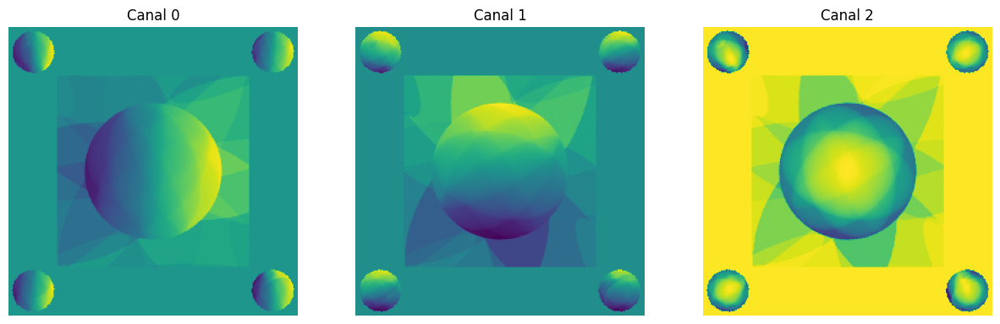

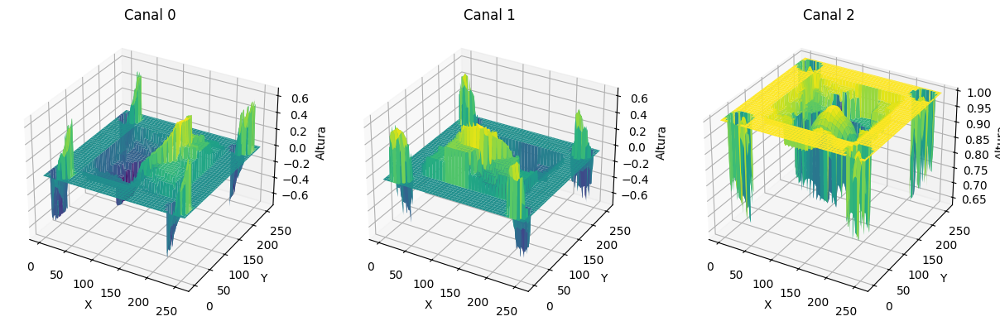

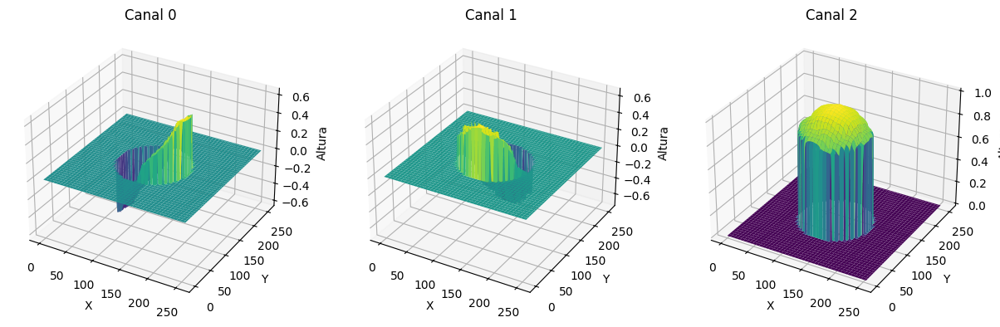

In [4]:
normals = estimate_normals(images, light_sources)
plotar_canais(normals)
plotar_canais_3d(normals)
normal_with_mask = normals * mask[:, :, np.newaxis]
plotar_canais_3d(normal_with_mask)

Informações estatísticas dos canais:
Canal 0:
  Mínimo: -0.9776277542114258
  Máximo: 0.9740274548530579
  Média: 0.029491113498806953
  Desvio Padrão: 0.26368457078933716
Canal 1:
  Mínimo: -0.9733941555023193
  Máximo: 0.9761302471160889
  Média: -0.03174178674817085
  Desvio Padrão: 0.241735577583313
Canal 2:
  Mínimo: -0.6599929928779602
  Máximo: 0.9999972581863403
  Média: 0.9094325304031372
  Desvio Padrão: 0.20758064091205597


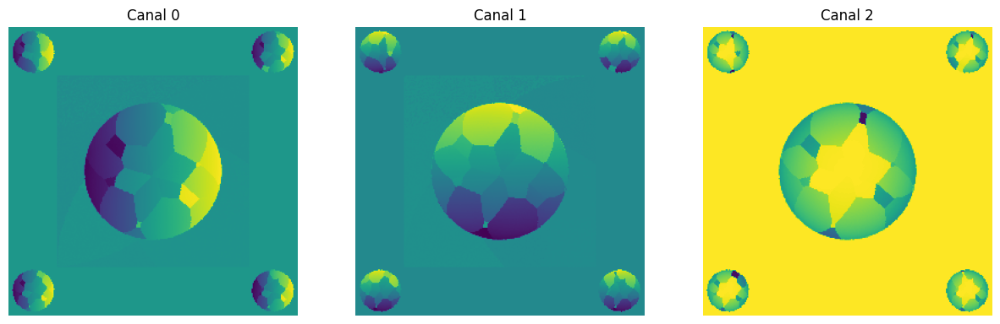

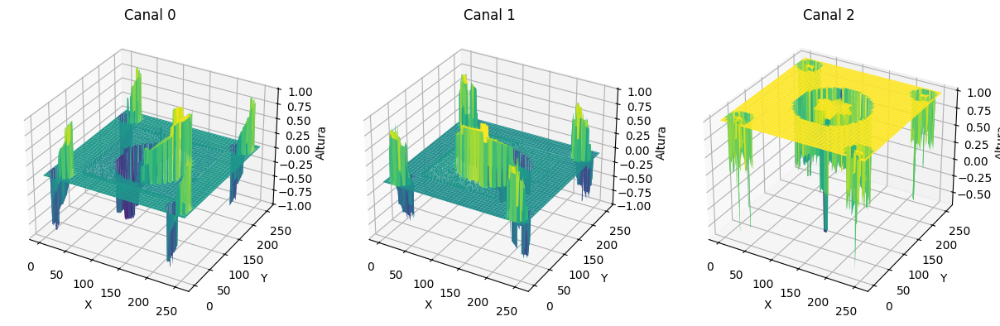

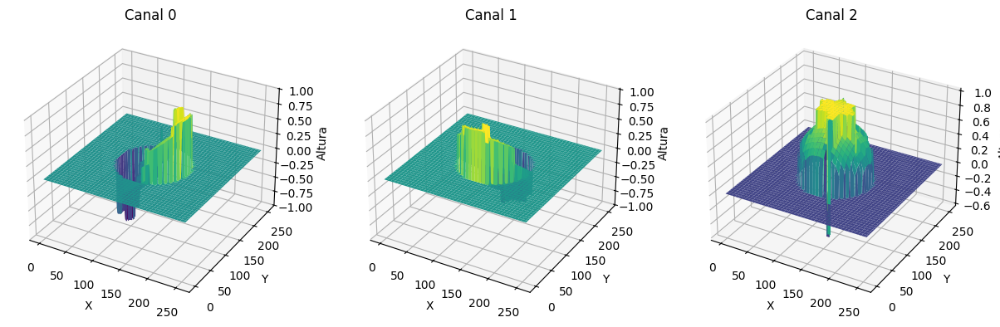

In [7]:
def estimate_normals_argmax(images, light_sources):
    images = images + 1e-6  # Adiciona um pequeno valor para evitar divisão por zero
    
    h, w, num_images = images.shape
    normals = np.zeros((h, w, 3), dtype=np.float32)

    for i in range(h):
        for j in range(w):
            pixel_values = images[i, j, :]
            top_indices = np.argsort(pixel_values)[-3:]  # Obtém os índices dos 3 maiores valores
            selected_values = pixel_values[top_indices]
            selected_lights = light_sources[top_indices, :]

            # Resolver o sistema linear I = L * N
            normal = np.linalg.lstsq(selected_lights, selected_values, rcond=None)[0]

            # Normalizar a normal
            normal /= np.linalg.norm(normal)
            normals[i, j, :] = normal

    return normals



normals = estimate_normals_argmax(images, light_sources)

plotar_canais(normals)
plotar_canais_3d(normals)
normal_with_mask = normals * mask[:, :, np.newaxis]
plotar_canais_3d(normal_with_mask)

Informações estatísticas dos canais:
Canal 0:
  Mínimo: -0.9776277542114258
  Máximo: 0.9740274548530579
  Média: 0.029491113498806953
  Desvio Padrão: 0.26368457078933716
Canal 1:
  Mínimo: -0.9733941555023193
  Máximo: 0.9761302471160889
  Média: -0.03174178674817085
  Desvio Padrão: 0.241735577583313
Canal 2:
  Mínimo: -0.6599929928779602
  Máximo: 0.9999972581863403
  Média: 0.9094325304031372
  Desvio Padrão: 0.20758064091205597


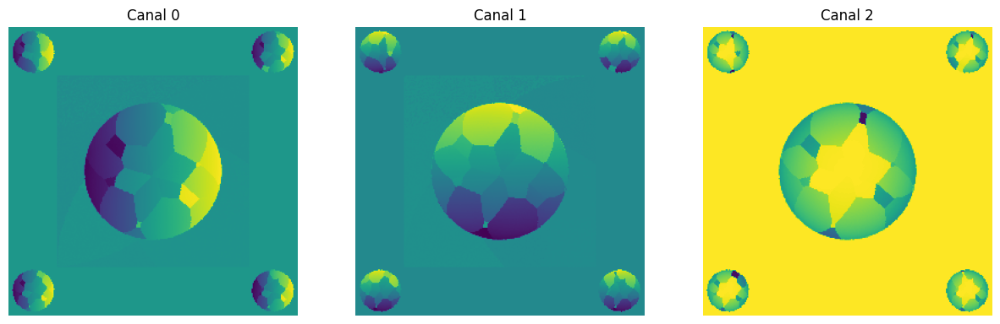

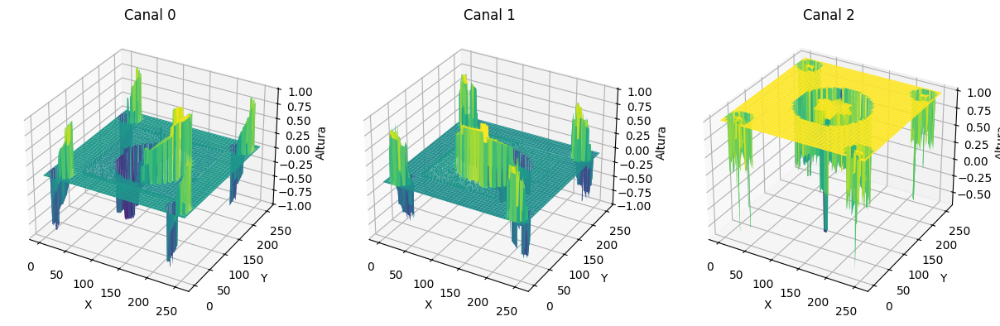

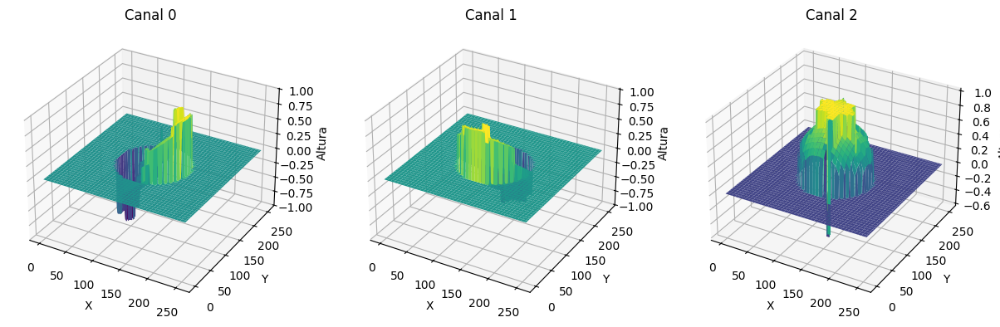

In [ ]:
def estimate_normals_argmax(images, light_sources):
    images = images + 1e-6  # Adiciona um pequeno valor para evitar divisão por zero
    
    h, w, num_images = images.shape
    normals = np.zeros((h, w, 3), dtype=np.float32)
    selected_areas = np.zeros((h, w, num_images), dtype=np.float32)

    for i in range(h):
        for j in range(w):
            pixel_values = images[i, j, :]
            top_indices = np.argsort(pixel_values)[-3:]  # Obtém os índices dos 3 maiores valores
            selected_values = pixel_values[top_indices]
            selected_lights = light_sources[top_indices, :]

            # Resolver o sistema linear I = L * N
            normal = np.linalg.lstsq(selected_lights, selected_values, rcond=None)[0]

            # Normalizar a normal
            normal /= np.linalg.norm(normal)
            normals[i, j, :] = normal

            selected_areas[i, j, top_indices] = 255

    return normals, selected_areas


normals, selected_areas = estimate_normals_argmax(images, light_sources)

plotar_canais(normals)
plotar_canais_3d(normals)
normal_with_mask = normals * mask[:, :, np.newaxis]
plotar_canais_3d(normal_with_mask)

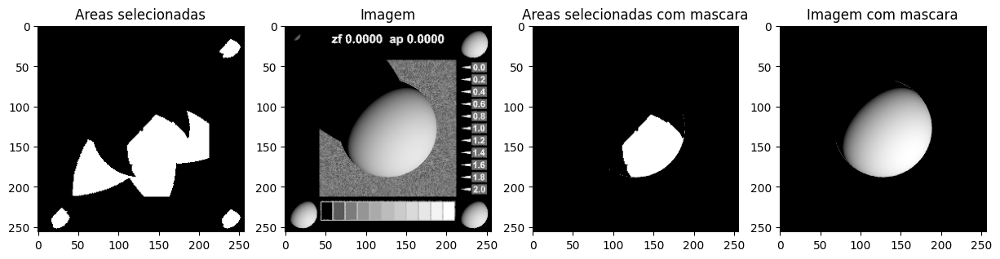

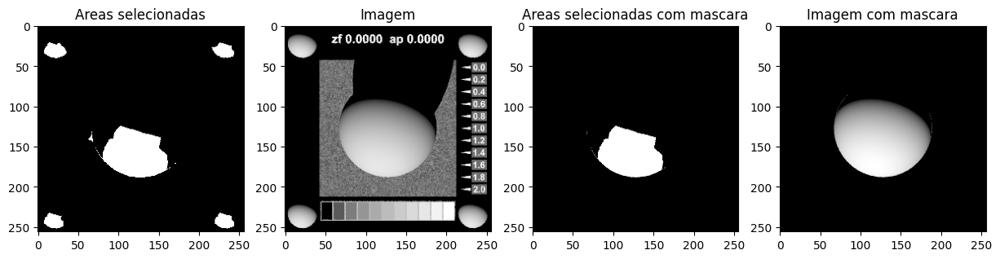

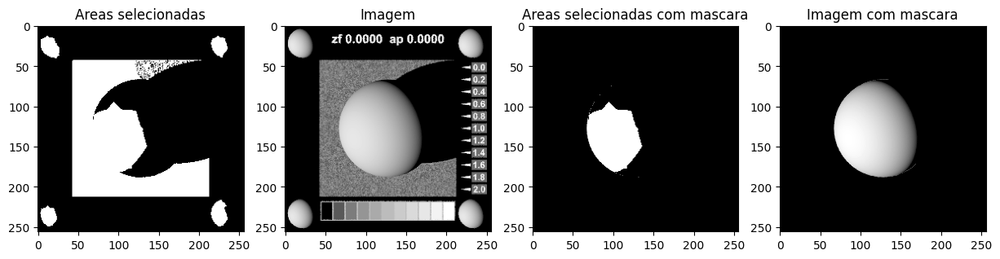

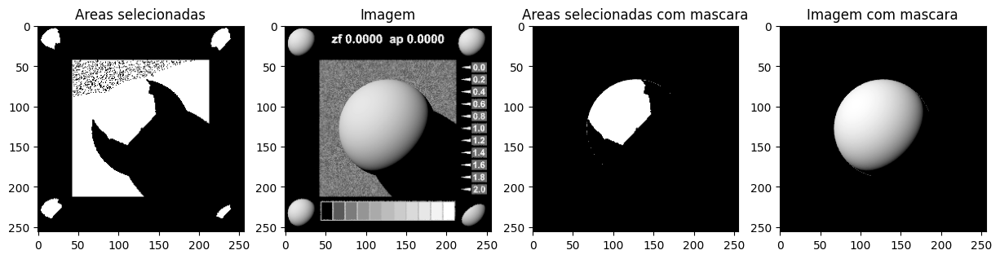

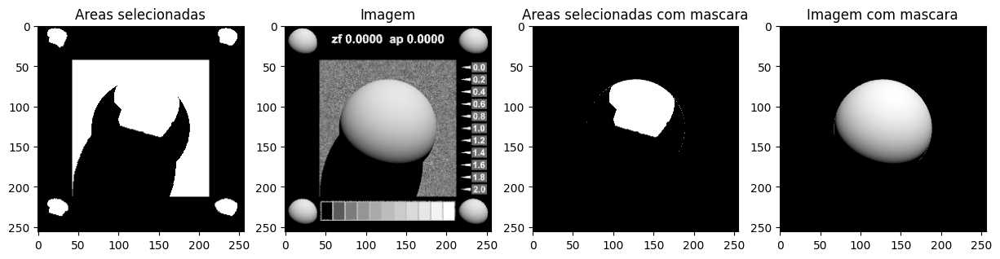

...

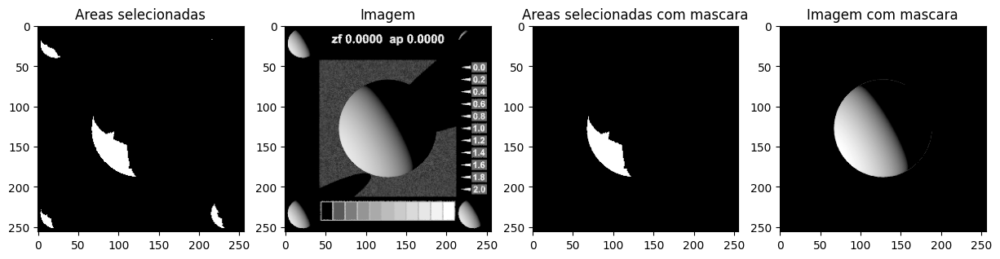

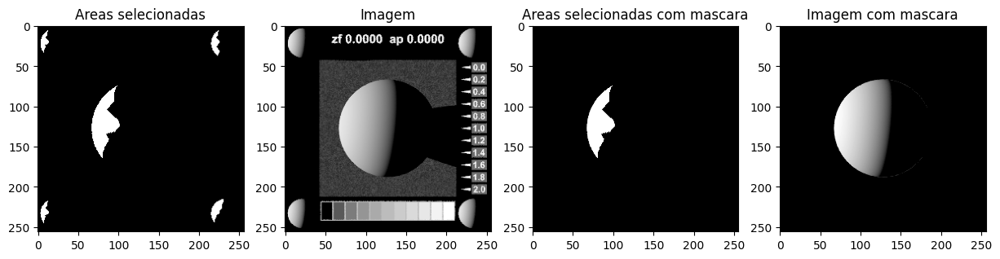

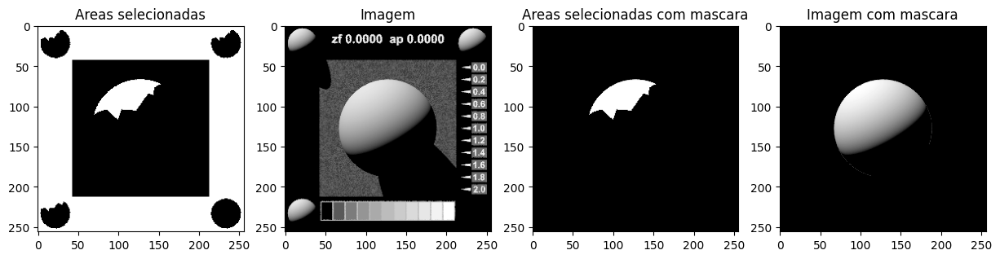

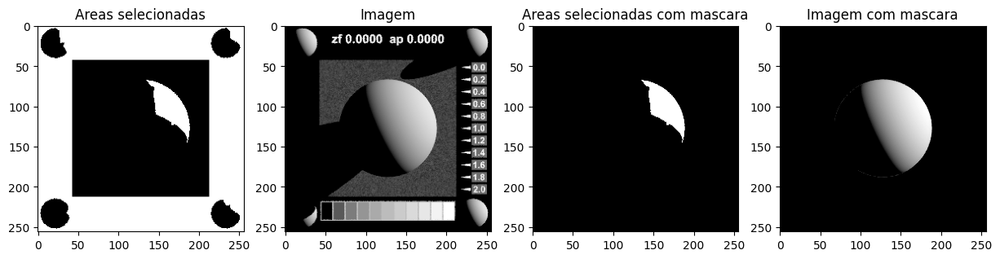

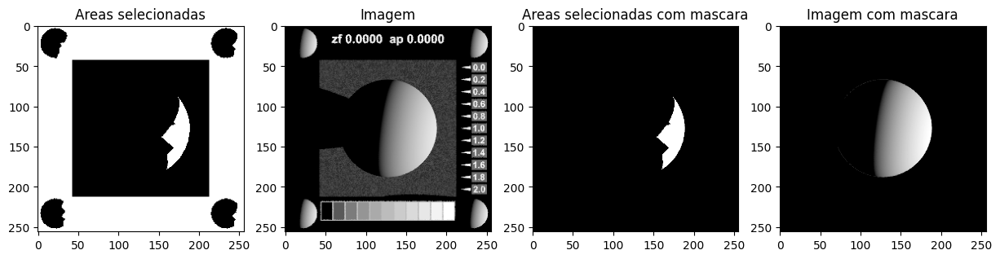

In [7]:
images_with_mask = images * mask[:, :, np.newaxis]
selected_areas_with_mask = selected_areas * mask[:, :, np.newaxis]


for i in range(12):
    #plt.imshow(selected_areas[:,:,i])

    fig, axs = plt.subplots(1, 4, figsize=(15, 8))

    axs[0].imshow(selected_areas[:,:,i], cmap='gray')
    axs[0].set_title('Areas selecionadas')
    

    axs[1].imshow(images[:,:,i], cmap='gray')
    axs[1].set_title('Imagem')

    axs[2].imshow(selected_areas_with_mask[:,:,i], cmap='gray')
    axs[2].set_title('Areas selecionadas com mascara')
    

    axs[3].imshow(images_with_mask[:,:,i], cmap='gray')
    axs[3].set_title('Imagem com mascara')

    plt.show()

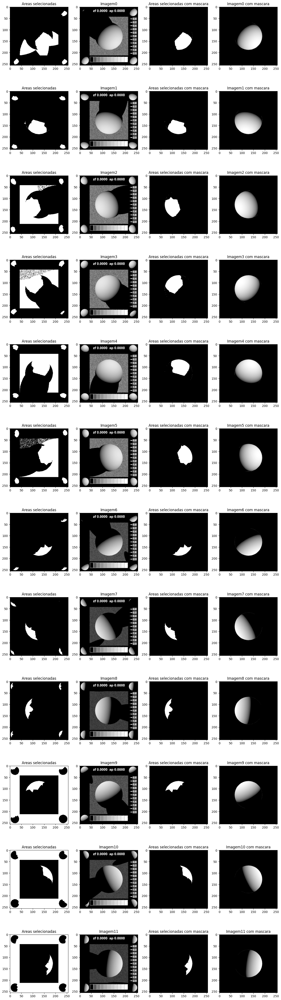

In [8]:
images_with_mask = images * mask[:, :, np.newaxis]
selected_areas_with_mask = selected_areas * mask[:, :, np.newaxis]
h, w, num_images = selected_areas_with_mask.shape

fig, axs = plt.subplots(num_images, 4, figsize=(16, 60))

for i in range(num_images):

    axs[i, 0].imshow(selected_areas[:,:,i], cmap='gray')
    axs[i, 0] .set_title('Areas selecionadas')
    
    axs[i, 1].imshow(images[:,:,i], cmap='gray')
    axs[i, 1].set_title(f'Imagem{i}')

    axs[i, 2].imshow(selected_areas_with_mask[:,:,i], cmap='gray')
    axs[i, 2] .set_title('Areas selecionadas com mascara')
    
    axs[i, 3].imshow(images_with_mask[:,:,i], cmap='gray')
    axs[i, 3].set_title(f'Imagem{i} com mascara')
plt.show()

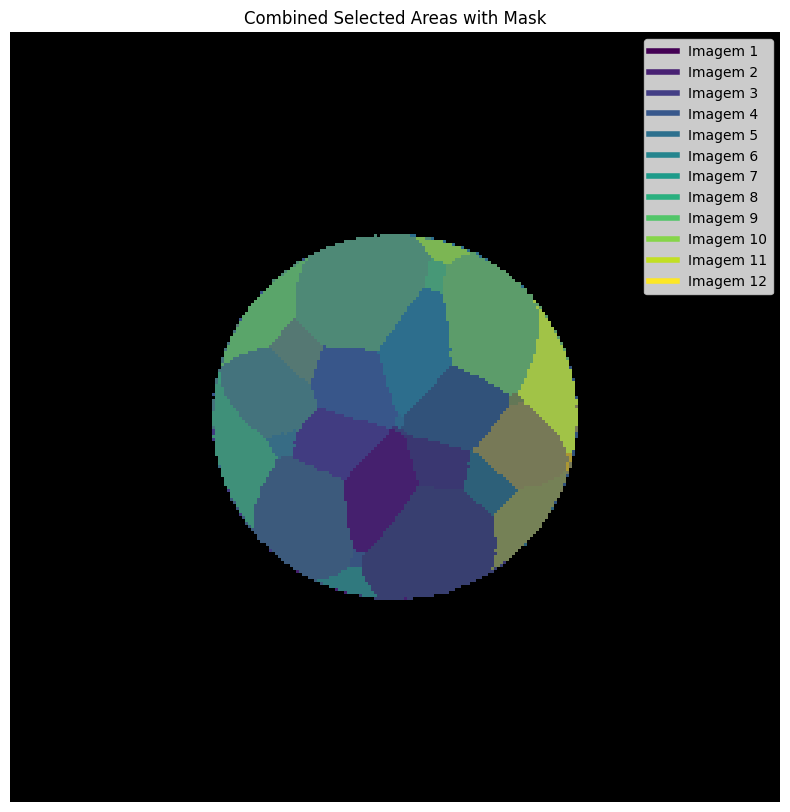

In [9]:
colors = plt.cm.viridis(np.linspace(0, 1, 12))

fig, ax = plt.subplots(figsize=(10, 10))

# Inicializa uma imagem vazia com as mesmas dimensões das imagens originais
combined_image = np.zeros((h, w, 3), dtype=np.float32)

# Inicializa um mapa para rastrear as sobreposições
overlap_count = np.zeros((h, w), dtype=np.float32)

# Adiciona cada imagem de selected_areas_with_mask à imagem combinada com uma cor diferente
for i in range(12):
    color = colors[i][:3]  # Obtém a cor correspondente (RGB)
    
    # Extrai a máscara binária atual
    mask_2 = selected_areas_with_mask[:, :, i]
    
    # Incrementa o número de sobreposições
    overlap_count += mask_2
    
    # Adiciona a cor ponderada pela máscara
    combined_image += np.stack([mask_2] * 3, axis=-1) * color

# Evita divisão por zero ao normalizar
overlap_count = np.maximum(overlap_count, 1)

# Normaliza a imagem combinada pelo número de sobreposições
combined_image /= np.stack([overlap_count] * 3, axis=-1)

# Plota a imagem final
ax.imshow(combined_image)
ax.set_title('Combined Selected Areas with Mask')
ax.axis('off')

# Adiciona a legenda
handles = [plt.Line2D([0], [0], color=colors[i], lw=4) for i in range(12)]
labels = [f'Imagem {i + 1}' for i in range(12)]
ax.legend(handles, labels, loc='upper right')

plt.show()


Pixel: 126, 126
Pixel values: [0.70980495 0.69804025 0.7647069  0.7647069  0.77255005 0.73725593
 0.4509814  0.43529513 0.4156873  0.53725594 0.4039226  0.34509906]
Top indices: [2 3 4]
Selected images: [0.7647069  0.7647069  0.77255005]
Selected lights: [[-0.708 -0.226  0.668]
 [-0.563  0.499  0.658]
 [ 0.229  0.689  0.686]]
Normal: [-0.03126319  0.02003623  0.99931034]

 ----------------- 

Pixel: 126, 127
Pixel values: [0.7137265  0.69804025 0.7568638  0.76078534 0.7764716  0.74509907
 0.45882455 0.4156873  0.39607945 0.5333344  0.42353043 0.3647069 ]
Top indices: [2 3 4]
Selected images: [0.7568638  0.76078534 0.7764716 ]
Selected lights: [[-0.708 -0.226  0.668]
 [-0.563  0.499  0.658]
 [ 0.229  0.689  0.686]]
Normal: [-0.02315388  0.02326743  0.99946112]

 ----------------- 

Pixel: 126, 128
Pixel values: [0.72156966 0.69804025 0.7529422  0.7568638  0.7764716  0.74902064
 0.46666768 0.4039226  0.38039318 0.52549124 0.43529513 0.38431475]
Top indices: [2 3 4]
Selected images: [0.75

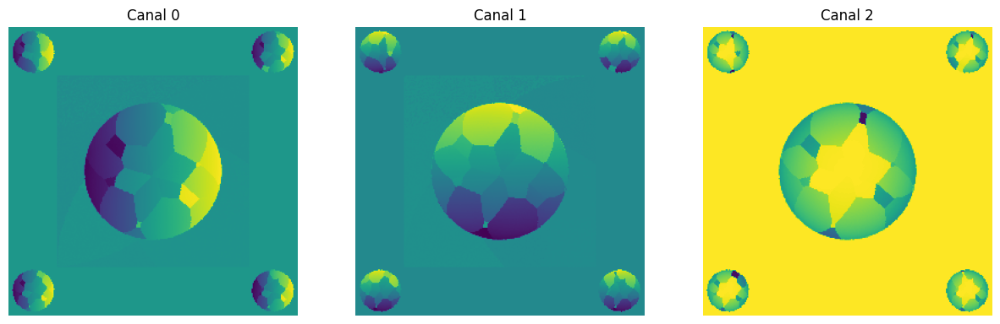

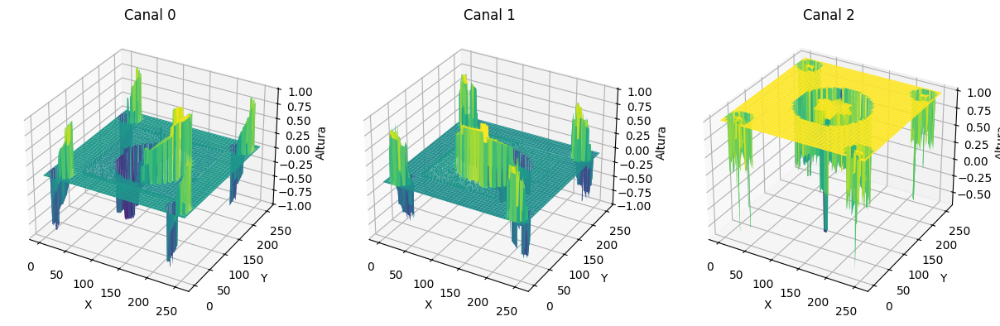

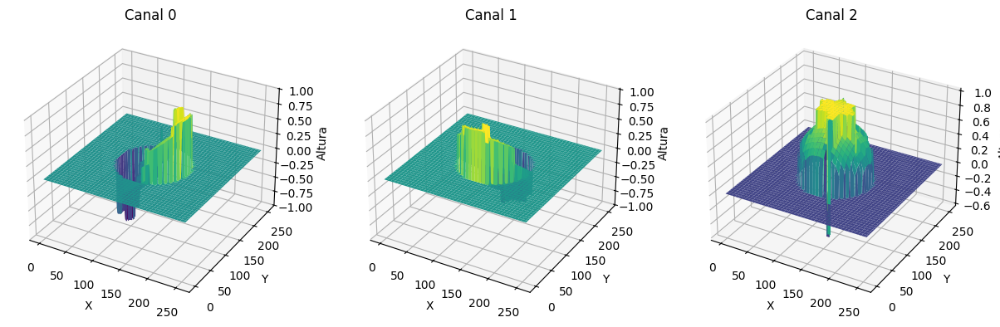

In [35]:
def estimate_normals_argmax(images, light_sources):
    images = images + 1e-6  # Adiciona um pequeno valor para evitar divisão por zero
    
    h, w, num_images = images.shape
    normals = np.zeros((h, w, 3), dtype=np.float32)
    selected_areas = np.zeros((h, w, num_images), dtype=np.float32)

    for i in range(h):
        for j in range(w):
            pixel_values = images[i, j, :]
            top_indices = np.argsort(pixel_values)[-3:]  # Obtém os índices dos 3 maiores valores
            selected_values = pixel_values[top_indices]
            selected_lights = light_sources[top_indices, :]

            # Resolver o sistema linear I = L * N
            normal = np.linalg.lstsq(selected_lights, selected_values, rcond=None)[0]

            # Normalizar a normal
            normal /= np.linalg.norm(normal)
            normals[i, j, :] = normal

            selected_areas[i, j, top_indices] = 255

            if 125 < i < 131 and 125 < j < 131:
                print(f'Pixel: {i}, {j}')
                print(f'Pixel values: {pixel_values}')
                print(f'Top indices: {top_indices}')
                print(f'Selected images: {selected_values}')
                print(f'Selected lights: {selected_lights}')
                print(f'Normal: {normal}')
                print('\n ----------------- \n')


    return normals, selected_areas


normals, selected_areas = estimate_normals_argmax(images, light_sources)

plotar_canais(normals)
plotar_canais_3d(normals)
normal_with_mask = normals * mask[:, :, np.newaxis]
plotar_canais_3d(normal_with_mask)

Pixel: 126, 126
Pixel values: [0.04313825 0.04313825 0.03921669 0.03529512 0.03921669 0.04313825]
Top indices: [3 2 4 1 0 5]
Selected images: [0.03529512 0.03921669 0.03921669 0.04313825 0.04313825 0.04313825]
Selected lights: [[ 0.1928592  -0.20537418  0.95949292]
 [ 0.13572569 -0.24688408  0.95949304]
 [ 0.23787466 -0.15095983  0.95949298]
 [ 0.07006404 -0.27288139  0.95949292]
 [ 0.         -0.28173256  0.95949292]
 [ 0.26794359 -0.08706014  0.95949304]]
Normal: [-0.53261812  0.64111661  0.55252822]

 ----------------- 

Pixel: 126, 127
Pixel values: [0.03137355 0.03137355 0.03137355 0.02353041 0.03137355 0.03529512]
Top indices: [3 0 1 2 4 5]
Selected images: [0.02353041 0.03137355 0.03137355 0.03137355 0.03137355 0.03529512]
Selected lights: [[ 0.1928592  -0.20537418  0.95949292]
 [ 0.         -0.28173256  0.95949292]
 [ 0.07006404 -0.27288139  0.95949292]
 [ 0.13572569 -0.24688408  0.95949304]
 [ 0.23787466 -0.15095983  0.95949298]
 [ 0.26794359 -0.08706014  0.95949304]]
Normal: 

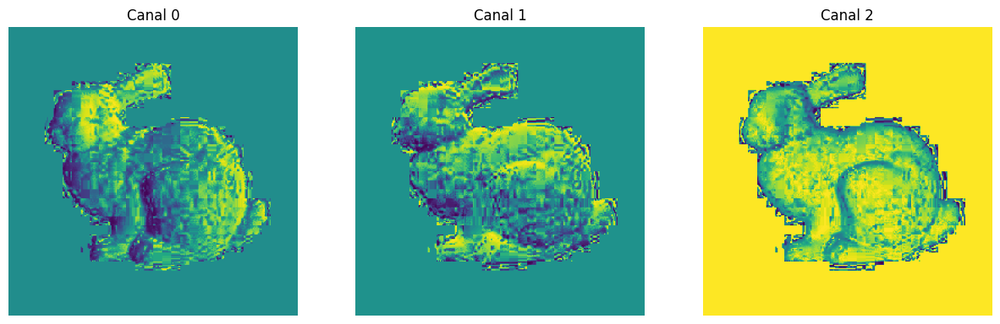

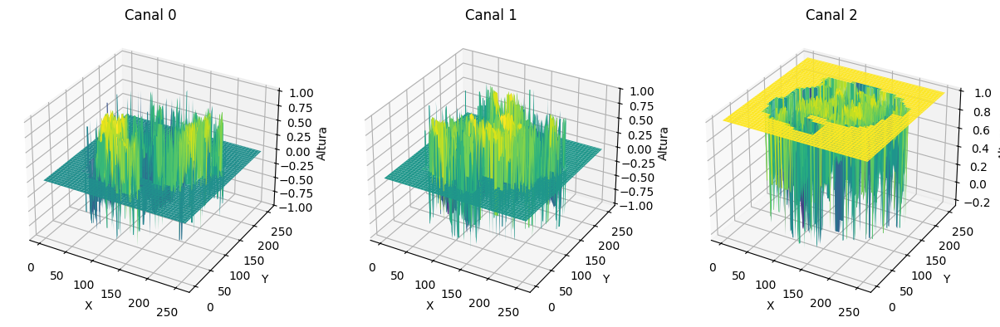

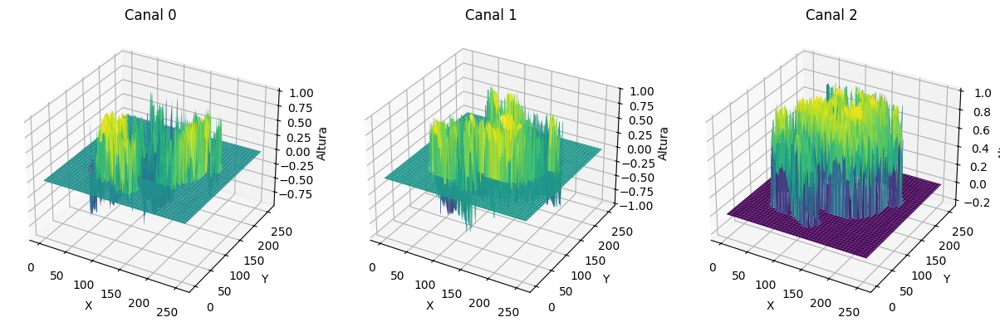

In [ ]:
def estimate_normals_argmax(images, light_sources):
    images = images + 1e-6  # Adiciona um pequeno valor para evitar divisão por zero
    
    h, w, num_images = images.shape
    normals = np.zeros((h, w, 3), dtype=np.float32)
    selected_areas = np.zeros((h, w, num_images), dtype=np.float32)

    for i in range(h):
        for j in range(w):
            pixel_values = images[i, j, :]
            top_indices = np.argsort(pixel_values)[-3:]  # Obtém os índices dos 3 maiores valores
            selected_values = pixel_values[top_indices]
            selected_lights = light_sources[top_indices, :]

            # Resolver o sistema linear I = L * N
            normal = np.linalg.lstsq(selected_lights, selected_values, rcond=None)[0]

            # Normalizar a normal
            normal /= np.linalg.norm(normal)
            normals[i, j, :] = normal

            selected_areas[i, j, top_indices] = 255

            if 125 < i < 131 and 125 < j < 131:
                print(f'Pixel: {i}, {j}')
                print(f'Pixel values: {pixel_values}')
                print(f'Top indices: {top_indices}')
                print(f'Selected images: {selected_values}')
                print(f'Selected lights: {selected_lights}')
                print(f'Normal: {normal}')
                print('\n ----------------- \n')


    return normals, selected_areas


normals, selected_areas = estimate_normals_argmax(images[:,:,:6], light_sources[:6, :])

plotar_canais(normals)
plotar_canais_3d(normals)
normal_with_mask = normals * mask[:, :, np.newaxis]
plotar_canais_3d(normal_with_mask)

Pixel: 126, 126
Pixel values: [0.70980495 0.69804025 0.7647069  0.7647069  0.77255005 0.73725593
 0.4509814  0.43529513 0.4156873  0.53725594 0.4039226  0.34509906]
Top indices: [4 2 0]
Selected images: [0.77255005 0.7647069  0.70980495]
Selected lights: [[ 0.229  0.689  0.686]
 [-0.708 -0.226  0.668]
 [ 0.567 -0.554  0.608]]
Normal: [ 0.00497701 -0.01727484  0.99983839]

 ----------------- 

Pixel: 126, 127
Pixel values: [0.7137265  0.69804025 0.7568638  0.76078534 0.7764716  0.74509907
 0.45882455 0.4156873  0.39607945 0.5333344  0.42353043 0.3647069 ]
Top indices: [4 2 0]
Selected images: [0.7764716 0.7568638 0.7137265]
Selected lights: [[ 0.229  0.689  0.686]
 [-0.708 -0.226  0.668]
 [ 0.567 -0.554  0.608]]
Normal: [ 0.01364109 -0.01490581  0.99979585]

 ----------------- 

Pixel: 126, 128
Pixel values: [0.72156966 0.69804025 0.7529422  0.7568638  0.7764716  0.74902064
 0.46666768 0.4039226  0.38039318 0.52549124 0.43529513 0.38431475]
Top indices: [4 2 0]
Selected images: [0.77647

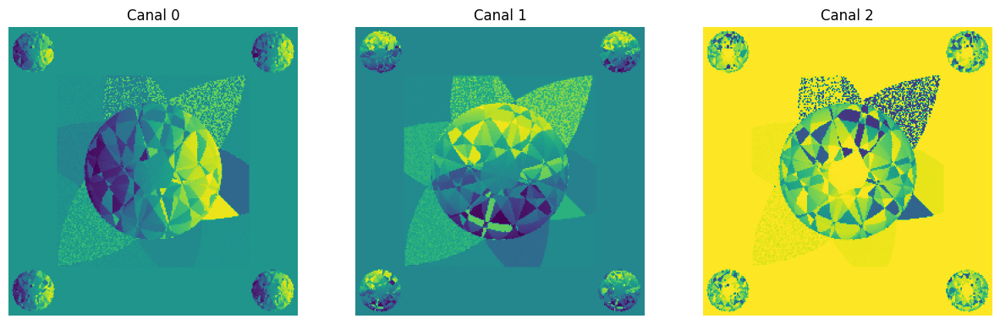

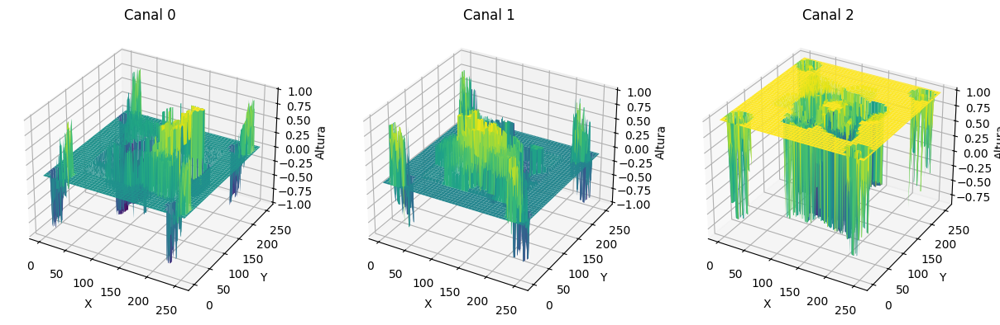

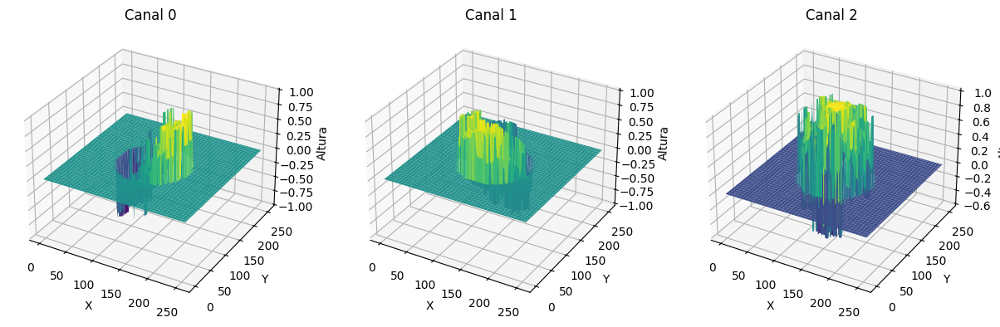

In [36]:
def estimate_normals_argmax(images, light_sources):
    images = images + 1e-6  # Adiciona um pequeno valor para evitar divisão por zero
    
    h, w, num_images = images.shape
    normals = np.zeros((h, w, 3), dtype=np.float32)
    selected_areas = np.zeros((h, w, num_images), dtype=np.float32)

    for i in range(h):
        for j in range(w):
            pixel_values = images[i, j, :]
            top_indices = np.argsort(pixel_values)[[11, 9, 7]]  
            selected_values = pixel_values[top_indices]
            selected_lights = light_sources[top_indices, :]

            # Resolver o sistema linear I = L * N
            normal = np.linalg.lstsq(selected_lights, selected_values, rcond=None)[0]

            # Normalizar a normal
            normal /= np.linalg.norm(normal)
            normals[i, j, :] = normal

            selected_areas[i, j, top_indices] = 255

            if 125 < i < 131 and 125 < j < 131:
                print(f'Pixel: {i}, {j}')
                print(f'Pixel values: {pixel_values}')
                print(f'Top indices: {top_indices}')
                print(f'Selected images: {selected_values}')
                print(f'Selected lights: {selected_lights}')
                print(f'Normal: {normal}')
                print('\n ----------------- \n')


    return normals, selected_areas


normals, selected_areas = estimate_normals_argmax(images, light_sources)

plotar_canais(normals)
plotar_canais_3d(normals)
normal_with_mask = normals * mask[:, :, np.newaxis]
plotar_canais_3d(normal_with_mask)

In [10]:
images.shape
images_with_mask

(256, 256, 12)

In [11]:
for i in range(12):
    print(np.max(images[:,:,i]), np.min(images[:,:,i]))

1.0 0.0
1.0 0.0
1.0 0.0
1.0 0.0
1.0 0.0
1.0 0.0
1.0 0.0
1.0 0.0
1.0 0.0
1.0 0.0
1.0 0.0
1.0 0.0


In [12]:
for i in range(12):
    print(np.max(images_with_mask[:,:,i]), np.min(images_with_mask[:,:,i]))

0.9058823585510254 0.0
0.9058823585510254 0.0
0.9058823585510254 0.0
0.9058823585510254 0.0
0.9058823585510254 0.0
0.9058823585510254 0.0
0.9058823585510254 0.0
0.9058823585510254 0.0
0.9058823585510254 0.0
0.9058823585510254 0.0
0.9058823585510254 0.0
0.9058823585510254 0.0


Pixel: 138, 86
Pixel values: [3.6470690e-01 7.6078534e-01 9.0588337e-01 8.0392259e-01 4.4313827e-01
 1.0000000e-06]
Top indices: [1 3 2]
Selected images: [0.76078534 0.8039226  0.9058834 ]
Selected lights: [[-0.191 -0.794  0.576]
 [-0.563  0.499  0.658]
 [-0.708 -0.226  0.668]]
Normal: [-0.15269832 -0.0775484   0.98522559]

 ----------------- 

Informações estatísticas dos canais:
Canal 0:
  Mínimo: -0.9283781051635742
  Máximo: 0.8655610680580139
  Média: -0.0011966123711317778
  Desvio Padrão: 0.12391732633113861
Canal 1:
  Mínimo: -0.8911666870117188
  Máximo: 0.8960047960281372
  Média: -0.06046494096517563
  Desvio Padrão: 0.1408320814371109
Canal 2:
  Mínimo: -0.3266238868236542
  Máximo: 0.9999972581863403
  Média: 0.9787755608558655
  Desvio Padrão: 0.05614287406206131


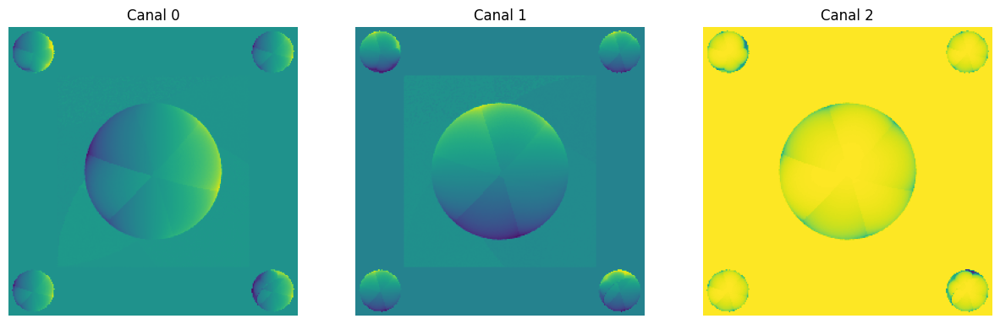

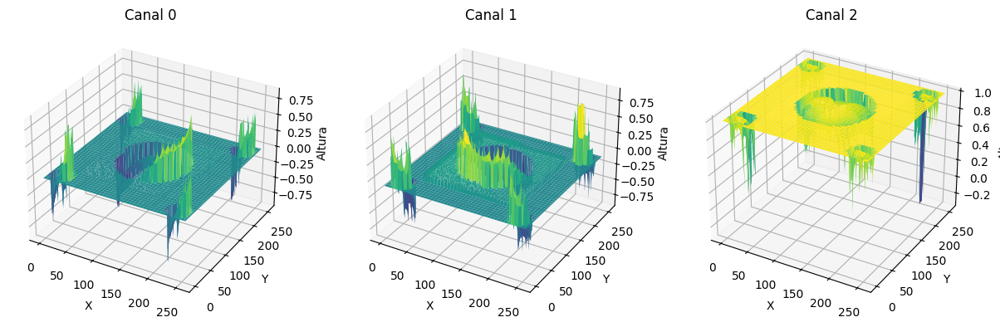

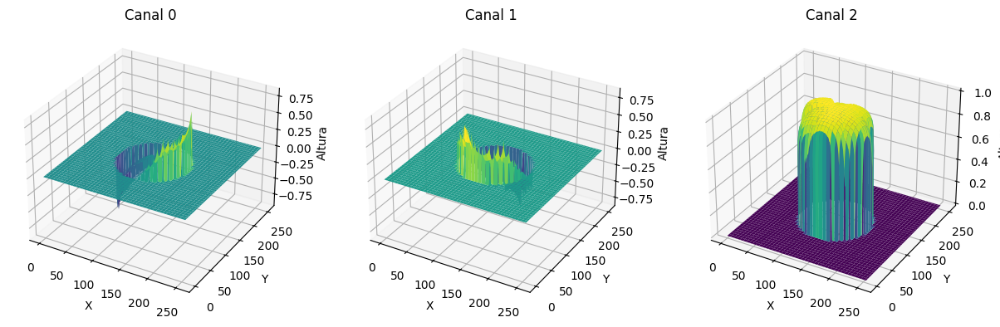

In [39]:
def estimate_normals_argmax(images, light_sources):
    images = images + 1e-6  # Adiciona um pequeno valor para evitar divisão por zero
    
    h, w, num_images = images.shape
    normals = np.zeros((h, w, 3), dtype=np.float32)
    selected_areas = np.zeros((h, w, num_images), dtype=np.float32)

    for i in range(h):
        for j in range(w):
            pixel_values = images[i, j, :]
            #top_indices = np.argsort(pixel_values)[[11, 9, 7]]  
            top_indices = np.argsort(pixel_values)[-3:]
            #print(top_indices)  
            selected_values = pixel_values[top_indices]
            selected_lights = light_sources[top_indices, :]

            # Resolver o sistema linear I = L * N de forma direta
            normal = np.dot(np.linalg.inv(selected_lights), selected_values)
            #normal = np.matmul(np.linalg.inv(selected_lights), selected_values)

            # Normalizar a normal
            normal /= np.linalg.norm(normal)
            normals[i, j, :] = normal

            selected_areas[i, j, top_indices] = 255
            
            if 137 < i < 139 and 85 < j < 87:
                print(f'Pixel: {i}, {j}')
                print(f'Pixel values: {pixel_values}')
                print(f'Top indices: {top_indices}')
                print(f'Selected images: {selected_values}')
                print(f'Selected lights: {selected_lights}')
                print(f'Normal: {normal}')
                print('\n ----------------- \n')
            
            if (list(top_indices) == [8, 7, 2]) and (55 < i < 200) and  (55 < j < 200):
                print(f'Pixel: {i}, {j}')
                print(f'Pixel values: {pixel_values}')
                print(f'Top indices: {top_indices}')
                print(f'Selected images: {selected_values}')
                print(f'Selected lights: {selected_lights}')
                print(f'Normal: {normal}')
                print('\n ----------------- \n')


    return normals, selected_areas


normals, selected_areas = estimate_normals_argmax(images[:,:,: 6], light_sources[:6, :])

plotar_canais(normals)
plotar_canais_3d(normals)
normal_with_mask = normals * mask[:, :, np.newaxis]
plotar_canais_3d(normal_with_mask)





In [20]:
images[138,128, 4]

np.float32(0.77254903)

## Input: ex15
---

In [ ]:
path = '/home/lelis/Documents/Projetos/hybrid-stereo-method/data/raw/photometric_stereo/bunny/images/'
image_paths = listar_arquivos(path)

light_path = '/home/lelis/Documents/Projetos/hybrid-stereo-method/data/raw/photometric_stereo/bunny/lights.npy'
light_sources = np.load(light_path)


mask_path = '/home/lelis/Documents/Projetos/hybrid-stereo-method/data/raw/photometric_stereo/bunny/mask.png'
mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE) / 255.0

images, light_sources = load_images_and_light_sources(image_paths, light_sources)

Pixel: 138, 86
Pixel values: [0.10196178 0.10196178 0.09411865 0.09804022 0.09804022 0.09804022
 0.09804022 0.09804022 0.10196178 0.10196178 0.10196178 0.10196178
 0.10196178 0.10980492 0.10588335 0.10588335 0.10980492 0.10588335
 0.10588335 0.10588335 0.10196178 0.10196178 0.10588335 0.10588335
 0.10196178 0.0627461  0.05882453 0.05882453 0.05882453 0.05490296
 0.05490296 0.05882453 0.05882453 0.05882453 0.06666767 0.07058924
 0.07451081 0.07451081 0.07451081 0.07843237 0.08235394 0.08235394
 0.08235394 0.08627551 0.08235394 0.08235394 0.07451081 0.07058924
 0.07058924 0.06666767]
Top indices: [19 16 13]
Selected images: [0.10588335 0.10980492 0.10980492]
Selected lights: [[-0.28117663 -0.01769014  0.95949298]
 [-0.2170787   0.17958304  0.95949304]
 [-0.03531042  0.279511    0.95949292]]
Normal: [-0.1205051   0.21919911  0.96820983]

 ----------------- 

Informações estatísticas dos canais:
Canal 0:
  Mínimo: -0.9999967813491821
  Máximo: 0.9982137680053711
  Média: 0.0213629752397537

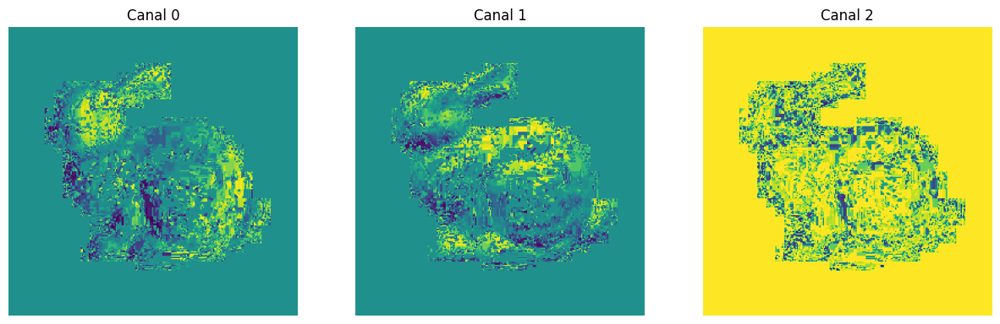

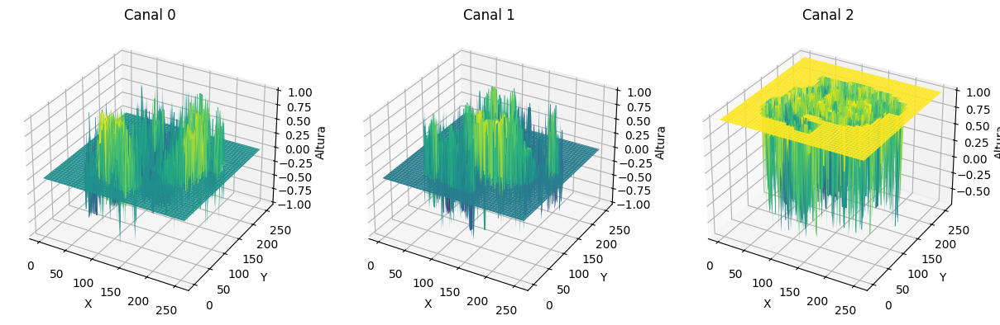

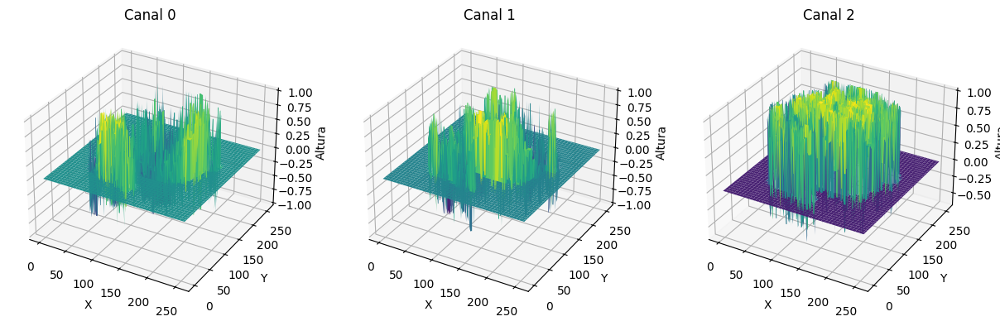

In [ ]:
def estimate_normals_argmax(images, light_sources):
    images = images + 1e-6  # Adiciona um pequeno valor para evitar divisão por zero
    
    h, w, num_images = images.shape
    normals = np.zeros((h, w, 3), dtype=np.float32)
    selected_areas = np.zeros((h, w, num_images), dtype=np.float32)

    for i in range(h):
        for j in range(w):
            pixel_values = images[i, j, :]
            #top_indices = np.argsort(pixel_values)[[11, 9, 7]]  
            top_indices = np.argsort(pixel_values)[-3:]
            #print(top_indices)  
            selected_values = pixel_values[top_indices]
            selected_lights = light_sources[top_indices, :]

            # Resolver o sistema linear I = L * N de forma direta
            #normal = np.dot(np.linalg.inv(selected_lights), selected_values)
            normal = np.matmul(np.linalg.inv(selected_lights), selected_values)

            # Normalizar a normal
            normal /= np.linalg.norm(normal)
            normals[i, j, :] = normal

            selected_areas[i, j, top_indices] = 255
            
            if 137 < i < 139 and 85 < j < 87:
                print(f'Pixel: {i}, {j}')
                print(f'Pixel values: {pixel_values}')
                print(f'Top indices: {top_indices}')
                print(f'Selected images: {selected_values}')
                print(f'Selected lights: {selected_lights}')
                print(f'Normal: {normal}')
                print('\n ----------------- \n')
            
            if (list(top_indices) == [8, 7, 2]) and (55 < i < 200) and  (55 < j < 200):
                print(f'Pixel: {i}, {j}')
                print(f'Pixel values: {pixel_values}')
                print(f'Top indices: {top_indices}')
                print(f'Selected images: {selected_values}')
                print(f'Selected lights: {selected_lights}')
                print(f'Normal: {normal}')
                print('\n ----------------- \n')


    return normals, selected_areas


normals, selected_areas = estimate_normals_argmax(images, light_sources)

plotar_canais(normals)
plotar_canais_3d(normals)
normal_with_mask = normals * mask[:, :, np.newaxis]
plotar_canais_3d(normal_with_mask)





Pixel: 126, 126
Pixel values: [4.31382544e-02 4.31382544e-02 3.92166860e-02 3.52951176e-02
 3.92166860e-02 4.31382544e-02 4.31382544e-02 5.09813912e-02
 5.49029596e-02 5.88245280e-02 6.27461001e-02 7.05892369e-02
 7.84323737e-02 7.84323737e-02 8.62755105e-02 8.62755105e-02
 9.01970789e-02 8.62755105e-02 8.23539421e-02 7.84323737e-02
 7.84323737e-02 6.66676685e-02 6.27461001e-02 5.88245280e-02
 5.09813912e-02 9.99999997e-07 3.92256863e-03 3.92256863e-03
 3.92256863e-03 9.99999997e-07 9.99999997e-07 3.92256863e-03
 1.17657064e-02 1.96088441e-02 3.13735493e-02 5.09813912e-02
 6.66676685e-02 7.84323737e-02 9.41186473e-02 1.01961784e-01
 1.09804921e-01 1.09804921e-01 1.01961784e-01 9.80402157e-02
 8.62755105e-02 7.45108053e-02 5.49029596e-02 3.92166860e-02
 2.35304125e-02 3.92256863e-03]
Top indices: [18 15 14 17 44 16 38 43 39 42 41 40]
Selected images: [0.08235394 0.08627551 0.08627551 0.08627551 0.08627551 0.09019708
 0.09411865 0.09804022 0.10196178 0.10196178 0.10980492 0.10980492]
Sel

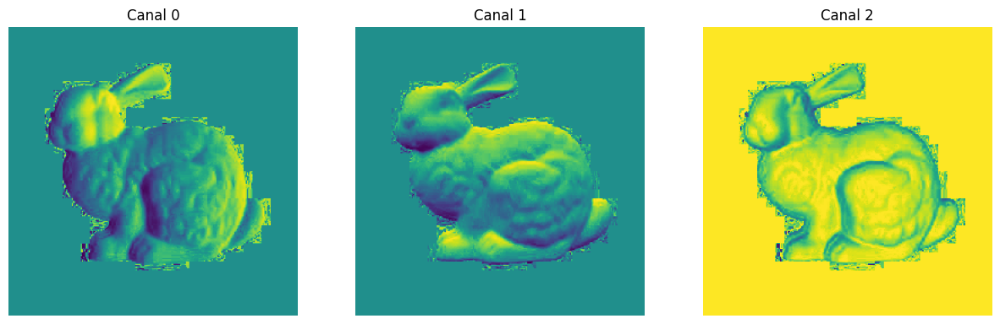

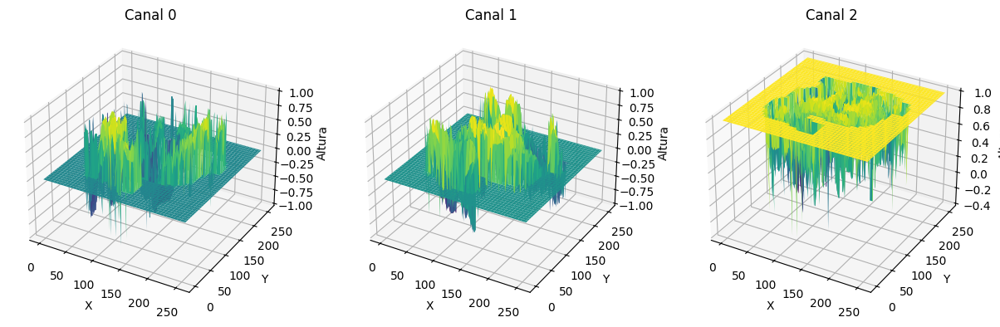

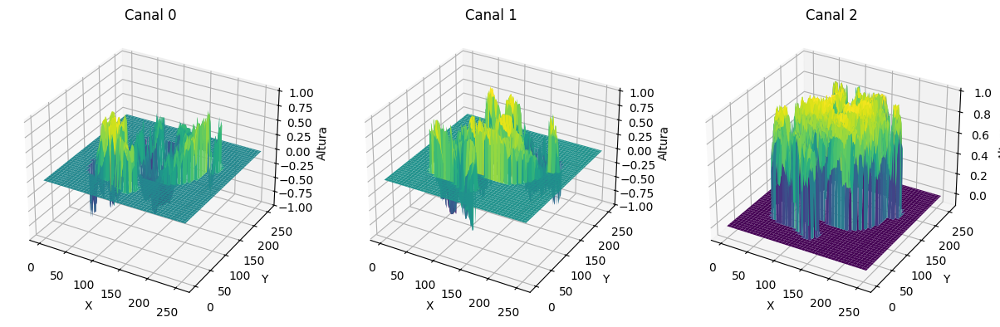

In [ ]:
def estimate_normals_argmax(images, light_sources):
    images = images + 1e-6  # Adiciona um pequeno valor para evitar divisão por zero
    
    h, w, num_images = images.shape
    normals = np.zeros((h, w, 3), dtype=np.float32)
    selected_areas = np.zeros((h, w, num_images), dtype=np.float32)

    for i in range(h):
        for j in range(w):
            pixel_values = images[i, j, :]
            top_indices = np.argsort(pixel_values)[-12:]  # Obtém os índices dos 3 maiores valores
            selected_values = pixel_values[top_indices]
            selected_lights = light_sources[top_indices, :]

            # Resolver o sistema linear I = L * N
            normal = np.linalg.lstsq(selected_lights, selected_values, rcond=None)[0]

            # Normalizar a normal
            normal /= np.linalg.norm(normal)
            normals[i, j, :] = normal

            selected_areas[i, j, top_indices] = 255

            if 125 < i < 131 and 125 < j < 131:
                print(f'Pixel: {i}, {j}')
                print(f'Pixel values: {pixel_values}')
                print(f'Top indices: {top_indices}')
                print(f'Selected images: {selected_values}')
                print(f'Selected lights: {selected_lights}')
                print(f'Normal: {normal}')
                print('\n ----------------- \n')


    return normals, selected_areas


normals, selected_areas = estimate_normals_argmax(images, light_sources)

plotar_canais(normals)
plotar_canais_3d(normals)
normal_with_mask = normals * mask[:, :, np.newaxis]
plotar_canais_3d(normal_with_mask)

In [ ]:
[3,5,7,1,3,6][-3:]

[1, 3, 6]

In [17]:
path = '/home/lelis/Documents/Projetos/hybrid-stereo-method/data/raw/photometric_stereo/bunny/images/'
image_paths = listar_arquivos(path)

light_path = '/home/lelis/Documents/Projetos/hybrid-stereo-method/data/raw/photometric_stereo/bunny/lights.npy'
light_sources = np.load(light_path)


mask_path = '/home/lelis/Documents/Projetos/hybrid-stereo-method/data/raw/photometric_stereo/bunny/mask.png'
mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE) / 255.0

images, light_sources = load_images_and_light_sources(image_paths, light_sources)

Pixel: 138, 86
Pixel values: [0.10196178 0.10196178 0.09411865 0.09804022 0.09804022 0.09804022
 0.09804022 0.09804022 0.10196178 0.10196178 0.10196178 0.10196178
 0.10196178 0.10980492 0.10588335 0.10588335 0.10980492 0.10588335
 0.10588335 0.10588335 0.10196178 0.10196178 0.10588335 0.10588335
 0.10196178 0.0627461  0.05882453 0.05882453 0.05882453 0.05490296
 0.05490296 0.05882453 0.05882453 0.05882453 0.06666767 0.07058924
 0.07451081 0.07451081 0.07451081 0.07843237 0.08235394 0.08235394
 0.08235394 0.08627551 0.08235394 0.08235394 0.07451081 0.07058924
 0.07058924 0.06666767]
Top indices: [19 16 13]
Selected images: [0.10588335 0.10980492 0.10980492]
Selected lights: [[-0.28117663 -0.01769014  0.95949298]
 [-0.2170787   0.17958304  0.95949304]
 [-0.03531042  0.279511    0.95949292]]
Normal: [-0.1205051   0.21919911  0.96820983]

 ----------------- 

Informações estatísticas dos canais:
Canal 0:
  Mínimo: -0.9999967813491821
  Máximo: 0.9982137680053711
  Média: 0.0213629752397537

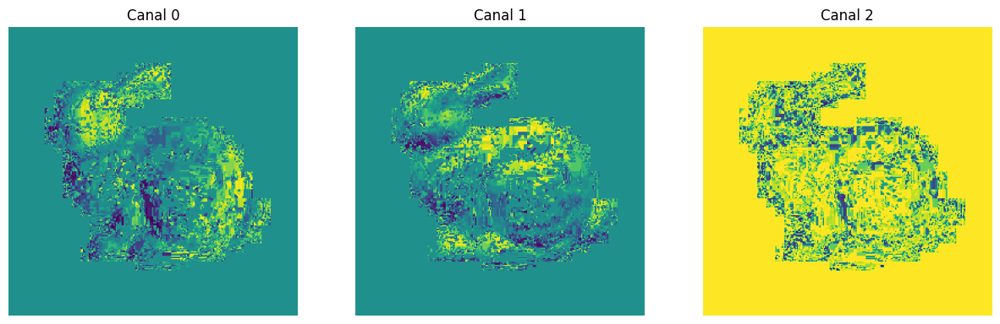

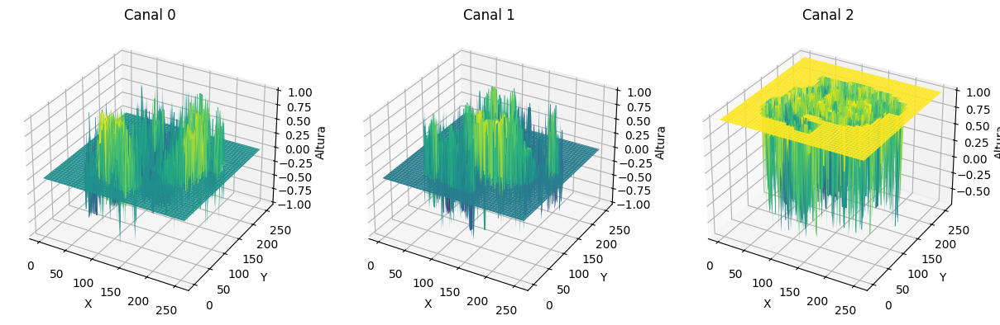

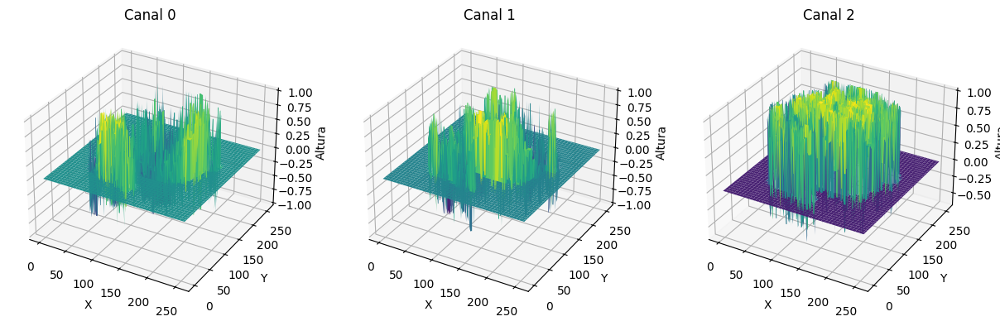

In [18]:
def estimate_normals_argmax(images, light_sources):
    images = images + 1e-6  # Adiciona um pequeno valor para evitar divisão por zero
    
    h, w, num_images = images.shape
    normals = np.zeros((h, w, 3), dtype=np.float32)
    selected_areas = np.zeros((h, w, num_images), dtype=np.float32)

    for i in range(h):
        for j in range(w):
            pixel_values = images[i, j, :]
            #top_indices = np.argsort(pixel_values)[[11, 9, 7]]  
            top_indices = np.argsort(pixel_values)[-3:]
            #print(top_indices)  
            selected_values = pixel_values[top_indices]
            selected_lights = light_sources[top_indices, :]

            # Resolver o sistema linear I = L * N de forma direta
            #normal = np.dot(np.linalg.inv(selected_lights), selected_values)
            normal = np.matmul(np.linalg.inv(selected_lights), selected_values)

            # Normalizar a normal
            normal /= np.linalg.norm(normal)
            normals[i, j, :] = normal

            selected_areas[i, j, top_indices] = 255
            
            if 137 < i < 139 and 85 < j < 87:
                print(f'Pixel: {i}, {j}')
                print(f'Pixel values: {pixel_values}')
                print(f'Top indices: {top_indices}')
                print(f'Selected images: {selected_values}')
                print(f'Selected lights: {selected_lights}')
                print(f'Normal: {normal}')
                print('\n ----------------- \n')
            
            if (list(top_indices) == [8, 7, 2]) and (55 < i < 200) and  (55 < j < 200):
                print(f'Pixel: {i}, {j}')
                print(f'Pixel values: {pixel_values}')
                print(f'Top indices: {top_indices}')
                print(f'Selected images: {selected_values}')
                print(f'Selected lights: {selected_lights}')
                print(f'Normal: {normal}')
                print('\n ----------------- \n')


    return normals, selected_areas


normals, selected_areas = estimate_normals_argmax(images, light_sources)

plotar_canais(normals)
plotar_canais_3d(normals)
normal_with_mask = normals * mask[:, :, np.newaxis]
plotar_canais_3d(normal_with_mask)





Pixel: 126, 126
Pixel values: [4.31382544e-02 4.31382544e-02 3.92166860e-02 3.52951176e-02
 3.92166860e-02 4.31382544e-02 4.31382544e-02 5.09813912e-02
 5.49029596e-02 5.88245280e-02 6.27461001e-02 7.05892369e-02
 7.84323737e-02 7.84323737e-02 8.62755105e-02 8.62755105e-02
 9.01970789e-02 8.62755105e-02 8.23539421e-02 7.84323737e-02
 7.84323737e-02 6.66676685e-02 6.27461001e-02 5.88245280e-02
 5.09813912e-02 9.99999997e-07 3.92256863e-03 3.92256863e-03
 3.92256863e-03 9.99999997e-07 9.99999997e-07 3.92256863e-03
 1.17657064e-02 1.96088441e-02 3.13735493e-02 5.09813912e-02
 6.66676685e-02 7.84323737e-02 9.41186473e-02 1.01961784e-01
 1.09804921e-01 1.09804921e-01 1.01961784e-01 9.80402157e-02
 8.62755105e-02 7.45108053e-02 5.49029596e-02 3.92166860e-02
 2.35304125e-02 3.92256863e-03]
Top indices: [18 15 14 17 44 16 38 43 39 42 41 40]
Selected images: [0.08235394 0.08627551 0.08627551 0.08627551 0.08627551 0.09019708
 0.09411865 0.09804022 0.10196178 0.10196178 0.10980492 0.10980492]
Sel

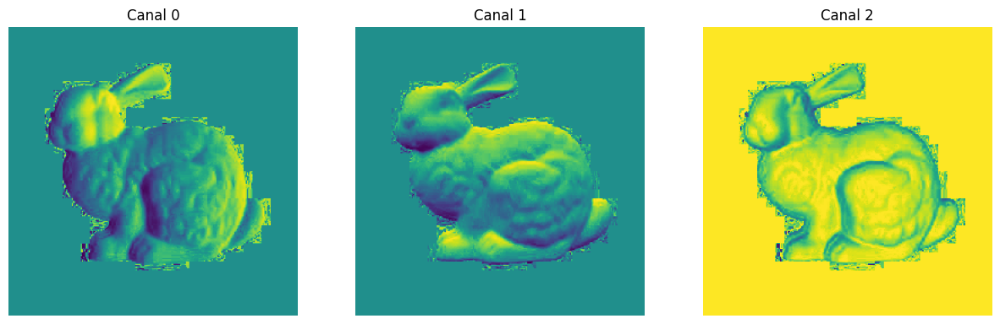

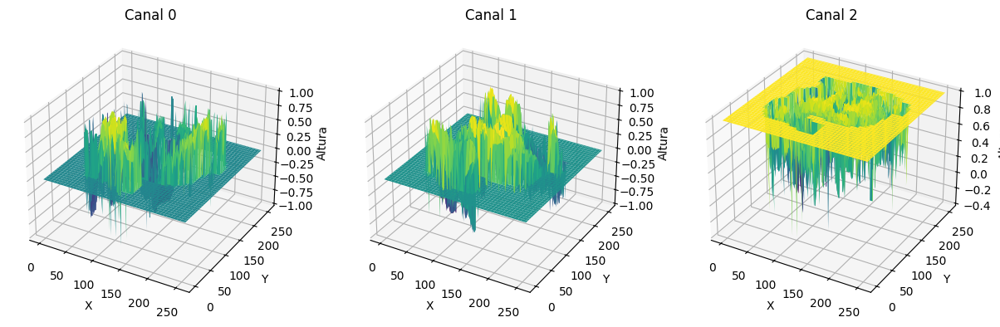

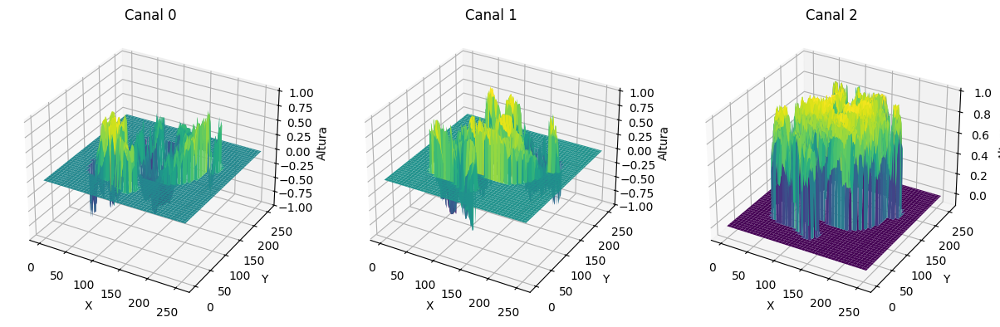

In [30]:
def estimate_normals_argmax(images, light_sources):
    images = images + 1e-6  # Adiciona um pequeno valor para evitar divisão por zero
    
    h, w, num_images = images.shape
    normals = np.zeros((h, w, 3), dtype=np.float32)
    selected_areas = np.zeros((h, w, num_images), dtype=np.float32)

    for i in range(h):
        for j in range(w):
            pixel_values = images[i, j, :]
            top_indices = np.argsort(pixel_values)[-12:]  # Obtém os índices dos 3 maiores valores
            selected_values = pixel_values[top_indices]
            selected_lights = light_sources[top_indices, :]

            # Resolver o sistema linear I = L * N
            normal = np.linalg.lstsq(selected_lights, selected_values, rcond=None)[0]

            # Normalizar a normal
            normal /= np.linalg.norm(normal)
            normals[i, j, :] = normal

            selected_areas[i, j, top_indices] = 255

            if 125 < i < 131 and 125 < j < 131:
                print(f'Pixel: {i}, {j}')
                print(f'Pixel values: {pixel_values}')
                print(f'Top indices: {top_indices}')
                print(f'Selected images: {selected_values}')
                print(f'Selected lights: {selected_lights}')
                print(f'Normal: {normal}')
                print('\n ----------------- \n')


    return normals, selected_areas


normals, selected_areas = estimate_normals_argmax(images, light_sources)

plotar_canais(normals)
plotar_canais_3d(normals)
normal_with_mask = normals * mask[:, :, np.newaxis]
plotar_canais_3d(normal_with_mask)

In [27]:
[3,5,7,1,3,6][-3:]

[1, 3, 6]

## Input: ex1

---

In [52]:
path = '/home/lelis/Documents/Projetos/hybrid-stereo-method/data/raw/photometric_stereo/ex1_muff/images/'
image_paths = listar_arquivos(path)

light_path = '/home/lelis/Documents/Projetos/hybrid-stereo-method/data/raw/photometric_stereo/ex1_muff/lights.npy'
light_sources = np.load(light_path)


mask_path = '/home/lelis/Documents/Projetos/hybrid-stereo-method/data/raw/photometric_stereo/ex1_muff/mask.png'
mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE) / 255.0

images, light_sources = load_images_and_light_sources(image_paths, light_sources)

Pixel: 138, 86
Pixel values: [0.3764716  0.51372653 0.5686285  0.6078442  0.48627552 0.48235396]
Top indices: [3 1 5]
Selected images: [0.6078442  0.51372653 0.48235396]
Selected lights: [[-0.56335134  0.4995294   0.65810762]
 [-0.19177893 -0.79435058  0.57639223]
 [ 0.73339395  0.21411166  0.64520501]]
Normal: [-0.10482667 -0.0080012   0.99445832]

 ----------------- 

Informações estatísticas dos canais:
Canal 0:
  Mínimo: -0.7369587421417236
  Máximo: 0.6014459729194641
  Média: -0.009857075288891792
  Desvio Padrão: 0.11192074418067932
Canal 1:
  Mínimo: -0.9541177153587341
  Máximo: 0.9921242594718933
  Média: -0.06202960014343262
  Desvio Padrão: 0.10545327514410019
Canal 2:
  Mínimo: 0.057175155729055405
  Máximo: 1.0
  Média: 0.9859851002693176
  Desvio Padrão: 0.015546727925539017


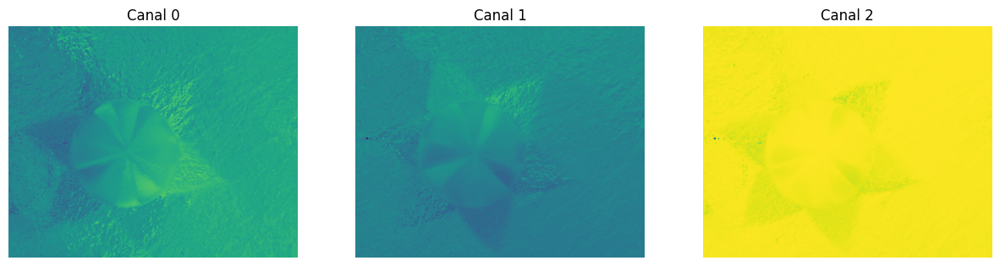

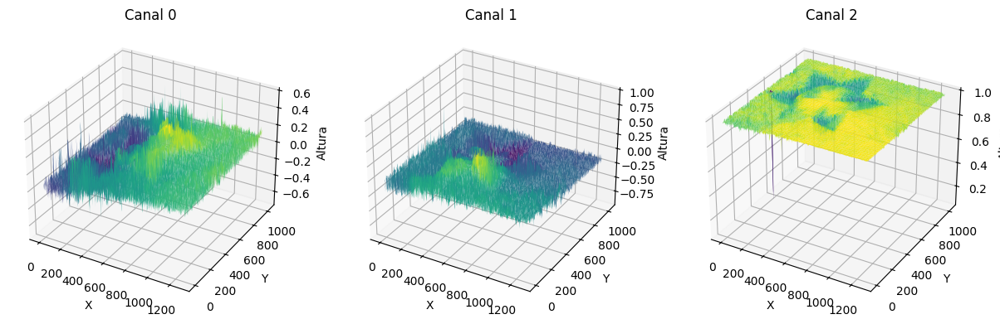

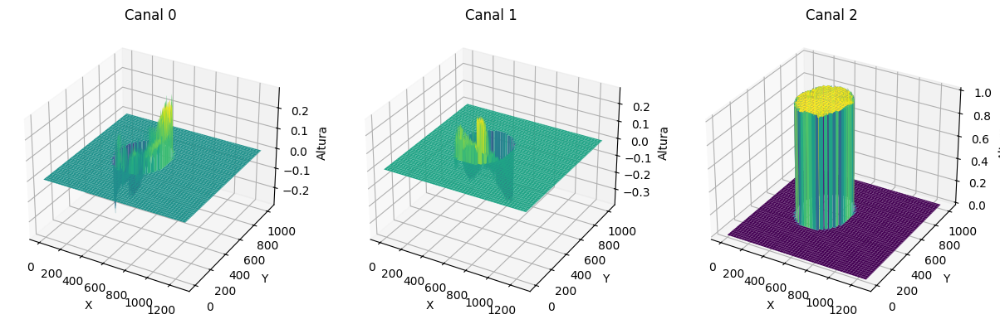

In [54]:
def estimate_normals_argmax(images, light_sources):
    images = images + 1e-6  # Adiciona um pequeno valor para evitar divisão por zero
    
    h, w, num_images = images.shape
    normals = np.zeros((h, w, 3), dtype=np.float32)
    selected_areas = np.zeros((h, w, num_images), dtype=np.float32)

    for i in range(h):
        for j in range(w):
            pixel_values = images[i, j, :]
            top_indices = np.argsort(pixel_values)[[5, 3, 1]]  
            #top_indices = np.argsort(pixel_values)[-3:]
            #print(top_indices)  
            selected_values = pixel_values[top_indices]
            selected_lights = light_sources[top_indices, :]

            # Resolver o sistema linear I = L * N de forma direta
            normal = np.dot(np.linalg.inv(selected_lights), selected_values)
            #normal = np.matmul(np.linalg.inv(selected_lights), selected_values)

            # Normalizar a normal
            normal /= np.linalg.norm(normal)
            normals[i, j, :] = normal

            selected_areas[i, j, top_indices] = 255
            
            if 137 < i < 139 and 85 < j < 87:
                print(f'Pixel: {i}, {j}')
                print(f'Pixel values: {pixel_values}')
                print(f'Top indices: {top_indices}')
                print(f'Selected images: {selected_values}')
                print(f'Selected lights: {selected_lights}')
                print(f'Normal: {normal}')
                print('\n ----------------- \n')
            
            if (list(top_indices) == [8, 7, 2]) and (55 < i < 200) and  (55 < j < 200):
                print(f'Pixel: {i}, {j}')
                print(f'Pixel values: {pixel_values}')
                print(f'Top indices: {top_indices}')
                print(f'Selected images: {selected_values}')
                print(f'Selected lights: {selected_lights}')
                print(f'Normal: {normal}')
                print('\n ----------------- \n')


    return normals, selected_areas


normals, selected_areas = estimate_normals_argmax(images, light_sources)

plotar_canais(normals)
plotar_canais_3d(normals)
normal_with_mask = normals * mask[:, :, np.newaxis]
plotar_canais_3d(normal_with_mask)





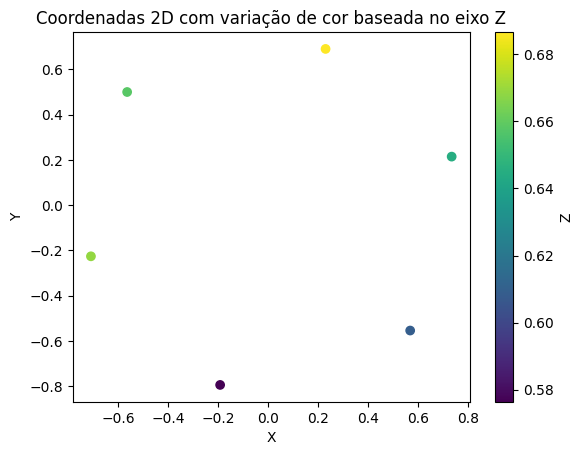

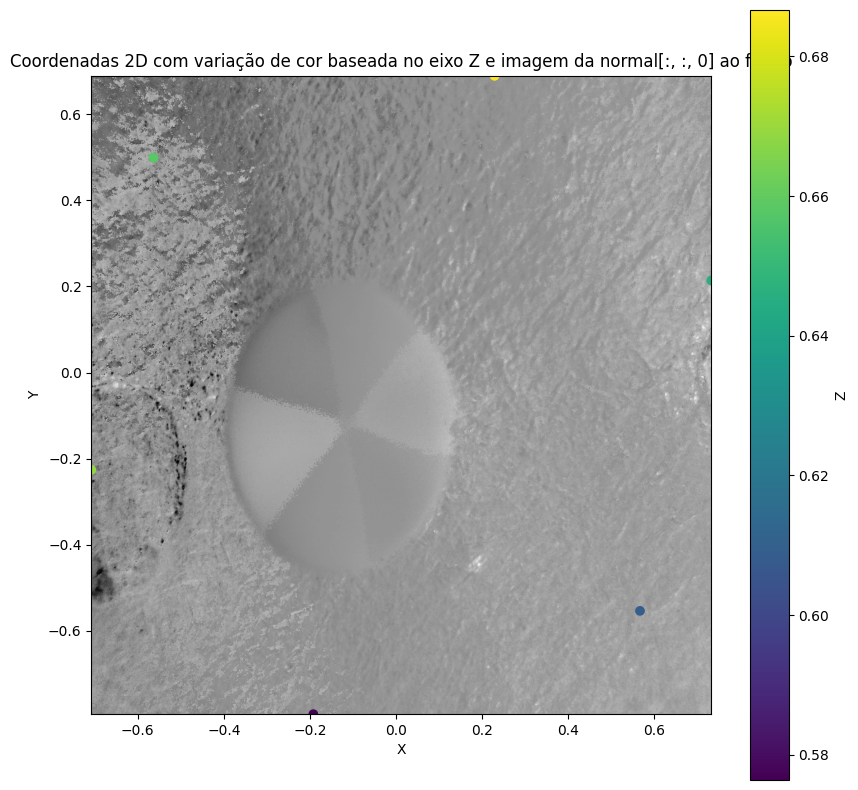

In [51]:
import numpy as np

import matplotlib.pyplot as plt

# Converter coordenate_list em um array numpy para facilitar a manipulação
coordenate_array = np.array(light_sources)



# Plotar as coordenadas em 2D com variação de cor baseada no eixo Z
plt.figure()
plt.scatter(coordenate_array[:, 0], coordenate_array[:, 1], c=coordenate_array[:, 2], cmap='viridis')
plt.colorbar(label='Z')
plt.xlabel('X')
plt.ylabel('Y')
plt.title('Coordenadas 2D com variação de cor baseada no eixo Z')
plt.show()


# Plotar as coordenadas em 2D com variação de cor baseada no eixo Z com a imagem da normal[:, :, 0] ao fundo
plt.figure(figsize=(10, 10))
plt.imshow(normals[:, :, 0], cmap='gray', extent=[coordenate_array[:, 0].min(), coordenate_array[:, 0].max(), coordenate_array[:, 1].min(), coordenate_array[:, 1].max()])
plt.scatter(coordenate_array[:, 0], coordenate_array[:, 1], c=coordenate_array[:, 2], cmap='viridis')
plt.colorbar(label='Z')
plt.xlabel('X')
plt.ylabel('Y')
plt.title('Coordenadas 2D com variação de cor baseada no eixo Z e imagem da normal[:, :, 0] ao fundo')
plt.gca().set_aspect('equal', adjustable='box')
plt.show()



Pixel: 126, 126
Pixel values: [0.4156873 0.5019618 0.5803932 0.682354  0.4901971 0.4784324]
Top indices: [0 5 4 1 2 3]
Selected images: [0.4156873 0.4784324 0.4901971 0.5019618 0.5803932 0.682354 ]
Selected lights: [[ 0.56761007 -0.55412473  0.60890442]
 [ 0.73339395  0.21411166  0.64520501]
 [ 0.22952551  0.68981053  0.68664363]
 [-0.19177893 -0.79435058  0.57639223]
 [-0.70801555 -0.22623676  0.66897751]
 [-0.56335134  0.4995294   0.65810762]]
Normal: [-0.14351451  0.02043784  0.98943715]

 ----------------- 

Pixel: 126, 127
Pixel values: [0.41960886 0.51372653 0.6039226  0.69804025 0.5333344  0.49411866]
Top indices: [0 5 1 4 2 3]
Selected images: [0.41960886 0.49411866 0.51372653 0.5333344  0.6039226  0.69804025]
Selected lights: [[ 0.56761007 -0.55412473  0.60890442]
 [ 0.73339395  0.21411166  0.64520501]
 [-0.19177893 -0.79435058  0.57639223]
 [ 0.22952551  0.68981053  0.68664363]
 [-0.70801555 -0.22623676  0.66897751]
 [-0.56335134  0.4995294   0.65810762]]
Normal: [-0.14179126

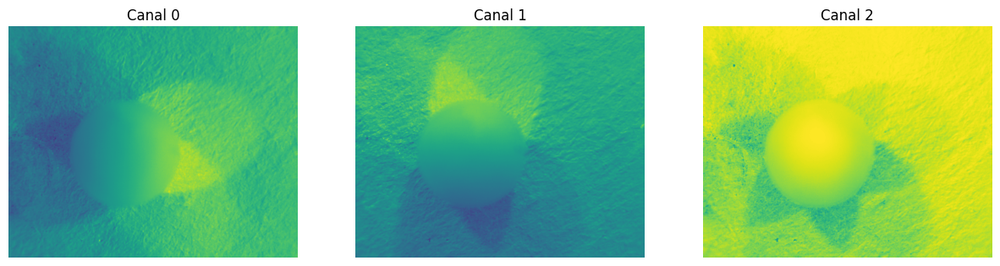

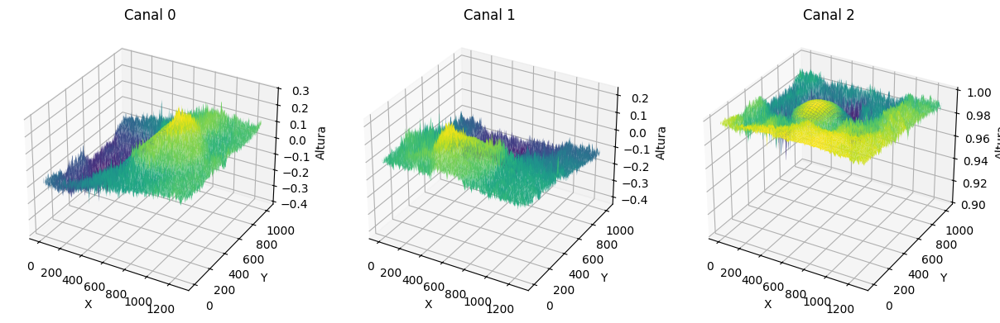

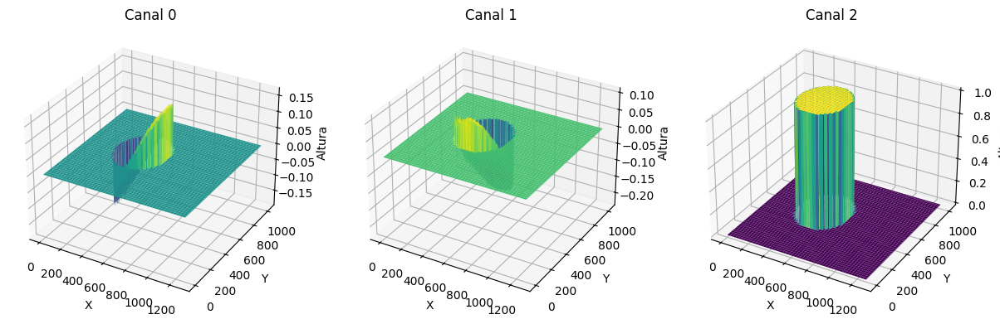

In [41]:
def estimate_normals_argmax(images, light_sources):
    images = images + 1e-6  # Adiciona um pequeno valor para evitar divisão por zero
    
    h, w, num_images = images.shape
    normals = np.zeros((h, w, 3), dtype=np.float32)
    selected_areas = np.zeros((h, w, num_images), dtype=np.float32)

    for i in range(h):
        for j in range(w):
            pixel_values = images[i, j, :]
            top_indices = np.argsort(pixel_values)[-6:]  # Obtém os índices dos 3 maiores valores
            selected_values = pixel_values[top_indices]
            selected_lights = light_sources[top_indices, :]

            # Resolver o sistema linear I = L * N
            normal = np.linalg.lstsq(selected_lights, selected_values, rcond=None)[0]

            # Normalizar a normal
            normal /= np.linalg.norm(normal)
            normals[i, j, :] = normal

            selected_areas[i, j, top_indices] = 255

            if 125 < i < 131 and 125 < j < 131:
                print(f'Pixel: {i}, {j}')
                print(f'Pixel values: {pixel_values}')
                print(f'Top indices: {top_indices}')
                print(f'Selected images: {selected_values}')
                print(f'Selected lights: {selected_lights}')
                print(f'Normal: {normal}')
                print('\n ----------------- \n')


    return normals, selected_areas


normals, selected_areas = estimate_normals_argmax(images, light_sources)

plotar_canais(normals)
plotar_canais_3d(normals)
normal_with_mask = normals * mask[:, :, np.newaxis]
plotar_canais_3d(normal_with_mask)

Informações estatísticas dos canais:
Canal 0:
  Mínimo: -0.4032604396343231
  Máximo: 0.29039305448532104
  Média: 0.0037828993517905474
  Desvio Padrão: 0.10271162539720535
Canal 1:
  Mínimo: -0.4300825297832489
  Máximo: 0.22921183705329895
  Média: -0.05993344634771347
  Desvio Padrão: 0.08590179681777954
Canal 2:
  Mínimo: 0.9004539251327515
  Máximo: 0.9999999403953552
  Média: 0.9891384840011597
  Desvio Padrão: 0.008350706659257412


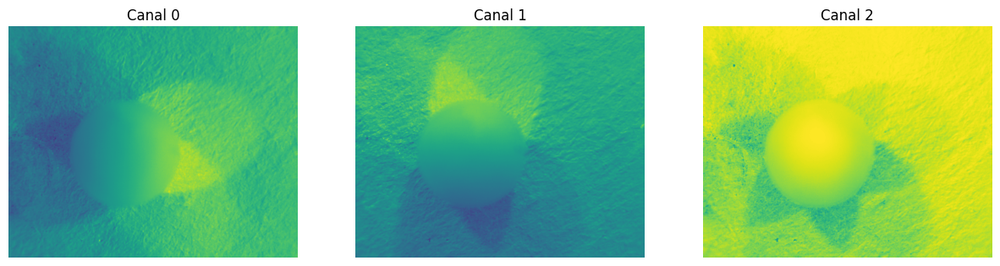

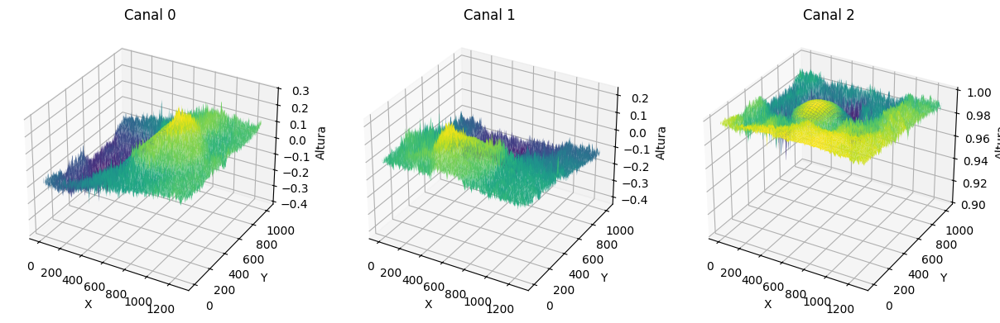

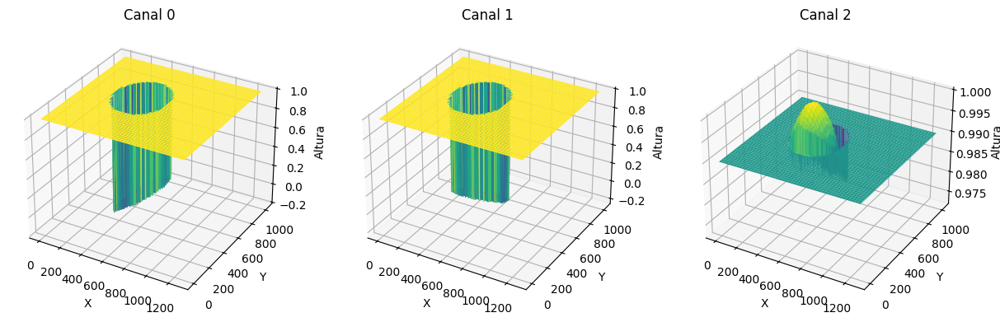

In [44]:
plotar_canais(normals)
plotar_canais_3d(normals)
normal_with_mask = normals * mask[:, :, np.newaxis]
normal_with_mask[normal_with_mask == 0] = 0.99
plotar_canais_3d(normal_with_mask)

In [45]:
light_sources

array([[ 0.56761007, -0.55412473,  0.60890442],
       [-0.19177893, -0.79435058,  0.57639223],
       [-0.70801555, -0.22623676,  0.66897751],
       [-0.56335134,  0.4995294 ,  0.65810762],
       [ 0.22952551,  0.68981053,  0.68664363],
       [ 0.73339395,  0.21411166,  0.64520501]])

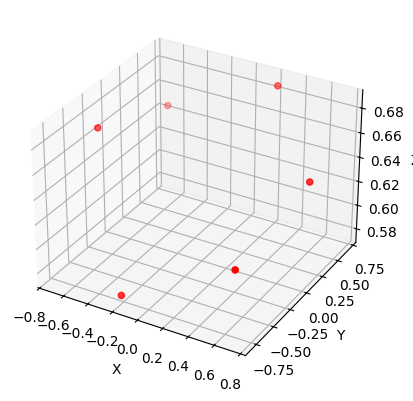

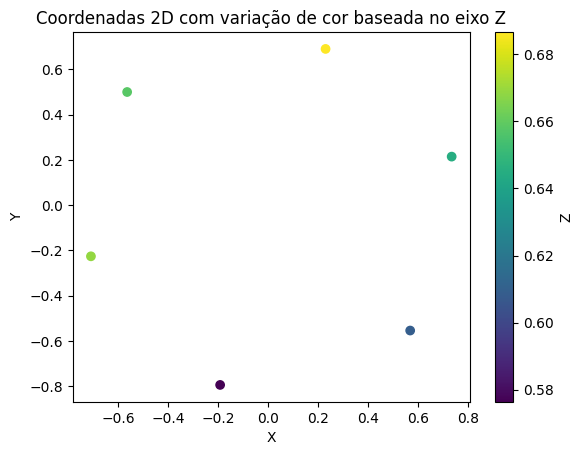

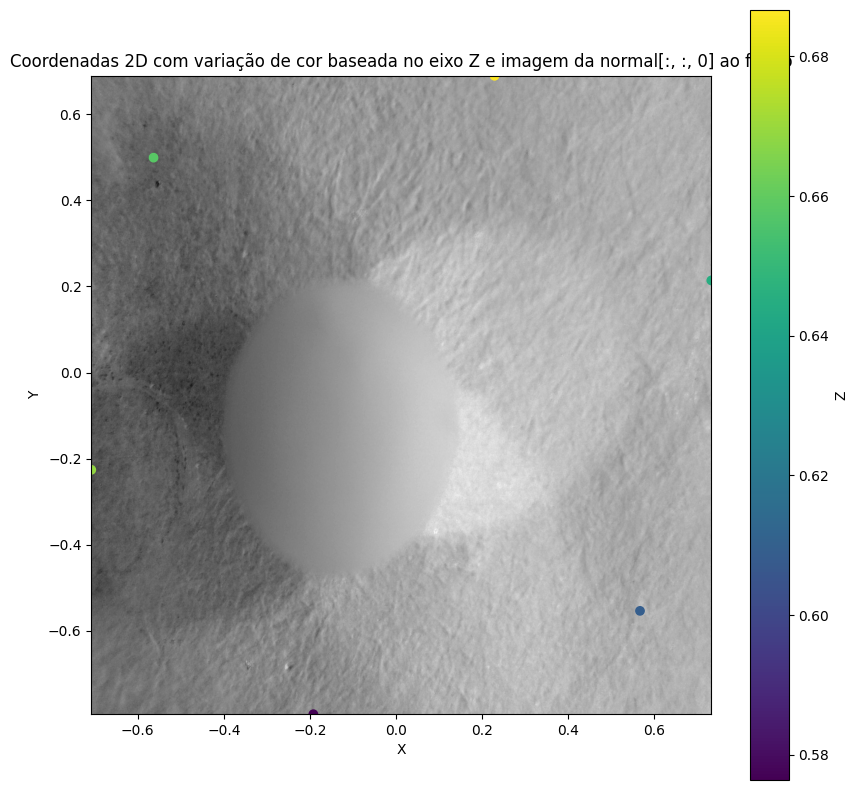

In [49]:
import numpy as np

import matplotlib.pyplot as plt

# Converter coordenate_list em um array numpy para facilitar a manipulação
coordenate_array = np.array(light_sources)

# Plotar as coordenadas
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Adicionar os pontos ao gráfico
ax.scatter(coordenate_array[:, 0], coordenate_array[:, 1], coordenate_array[:, 2], c='r', marker='o')

# Adicionar rótulos aos eixos
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')

# Mostrar o gráfico
plt.show()


# Plotar as coordenadas em 2D com variação de cor baseada no eixo Z
plt.figure()
plt.scatter(coordenate_array[:, 0], coordenate_array[:, 1], c=coordenate_array[:, 2], cmap='viridis')
plt.colorbar(label='Z')
plt.xlabel('X')
plt.ylabel('Y')
plt.title('Coordenadas 2D com variação de cor baseada no eixo Z')
plt.show()


# Plotar as coordenadas em 2D com variação de cor baseada no eixo Z com a imagem da normal[:, :, 0] ao fundo
plt.figure(figsize=(10, 10))
plt.imshow(normals[:, :, 0], cmap='gray', extent=[coordenate_array[:, 0].min(), coordenate_array[:, 0].max(), coordenate_array[:, 1].min(), coordenate_array[:, 1].max()])
plt.scatter(coordenate_array[:, 0], coordenate_array[:, 1], c=coordenate_array[:, 2], cmap='viridis')
plt.colorbar(label='Z')
plt.xlabel('X')
plt.ylabel('Y')
plt.title('Coordenadas 2D com variação de cor baseada no eixo Z e imagem da normal[:, :, 0] ao fundo')
plt.gca().set_aspect('equal', adjustable='box')
plt.show()



## Input: ex21
---

In [66]:
path = '/home/lelis/Documents/Projetos/hybrid-stereo-method/data/raw/photometric_stereo/ex18_povball-txF/images/'
image_paths = listar_arquivos(path)

light_path = '/home/lelis/Documents/Projetos/hybrid-stereo-method/data/raw/photometric_stereo/ex18_povball-txF/lights.npy'
light_sources = np.load(light_path)


mask_path = '/home/lelis/Documents/Projetos/hybrid-stereo-method/data/raw/photometric_stereo/ex18_povball-txF/mask.png'
mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE) / 255.0

images, light_sources = load_images_and_light_sources(image_paths, light_sources)

Pixel: 135, 82
Pixel values: [5.4902960e-02 5.0588340e-01 7.9607946e-01 6.3137358e-01 1.6862845e-01
 1.0000000e-06 1.0000000e-06 6.4705986e-01 6.4313829e-01 3.4117749e-01
 1.0000000e-06 1.0000000e-06]
Top indices: [8 7 2]
Selected images: [0.6431383  0.64705986 0.79607946]
Selected lights: [[-0.982  0.105  0.155]
 [-0.854 -0.484  0.19 ]
 [-0.708 -0.226  0.668]]
Normal: [-0.72415426 -0.12538788  0.67814341]

 ----------------- 

Pixel: 135, 83
Pixel values: [7.0589237e-02 5.0980496e-01 7.9607946e-01 6.3529515e-01 1.8039316e-01
 1.0000000e-06 1.0000000e-06 6.3921672e-01 6.3529515e-01 3.3725592e-01
 1.0000000e-06 1.0000000e-06]
Top indices: [8 7 2]
Selected images: [0.63529515 0.6392167  0.79607946]
Selected lights: [[-0.982  0.105  0.155]
 [-0.854 -0.484  0.19 ]
 [-0.708 -0.226  0.668]]
Normal: [-0.71112196 -0.1217011   0.69245534]

 ----------------- 

Pixel: 136, 79
Pixel values: [1.1765706e-02 4.9019709e-01 7.9215789e-01 6.1568731e-01 1.1764806e-01
 1.0000000e-06 1.0000000e-06 6.78432

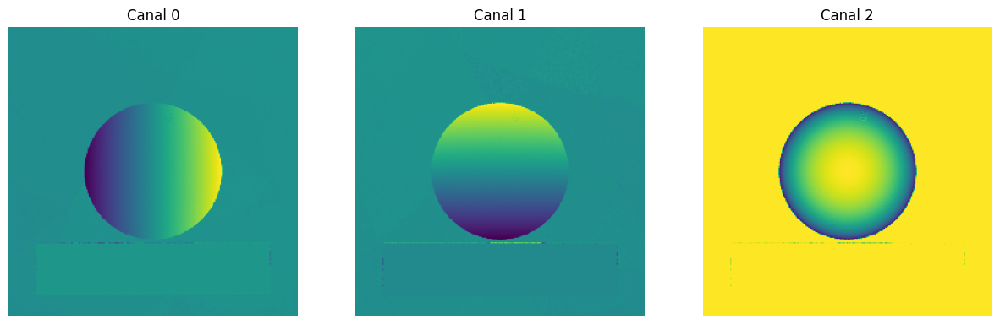

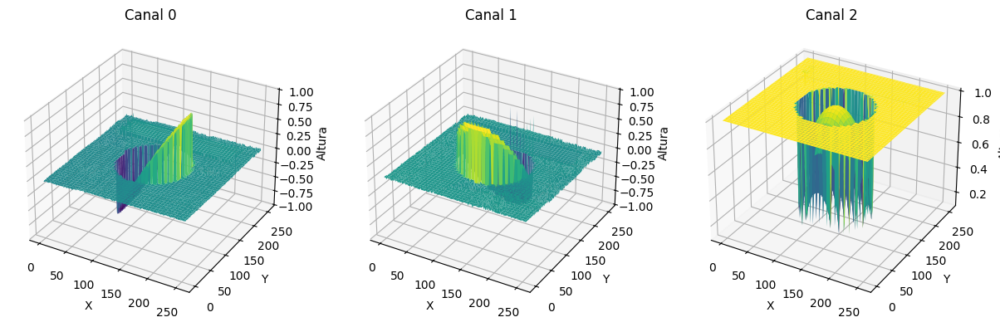

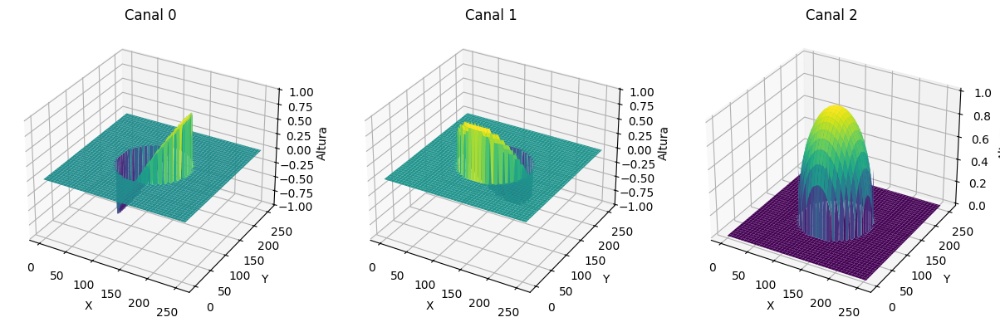

In [67]:
def estimate_normals_argmax(images, light_sources):
    images = images + 1e-6  # Adiciona um pequeno valor para evitar divisão por zero
    
    h, w, num_images = images.shape
    normals = np.zeros((h, w, 3), dtype=np.float32)
    selected_areas = np.zeros((h, w, num_images), dtype=np.float32)

    for i in range(h):
        for j in range(w):
            pixel_values = images[i, j, :]
            #top_indices = np.argsort(pixel_values)[[11, 9, 7]]  
            top_indices = np.argsort(pixel_values)[-3:]
            #print(top_indices)  
            selected_values = pixel_values[top_indices]
            selected_lights = light_sources[top_indices, :]

            # Resolver o sistema linear I = L * N de forma direta
            normal = np.dot(np.linalg.inv(selected_lights), selected_values)
            #normal = np.matmul(np.linalg.inv(selected_lights), selected_values)

            # Normalizar a normal
            normal /= np.linalg.norm(normal)
            normals[i, j, :] = normal

            selected_areas[i, j, top_indices] = 255
            
            if 137 < i < 139 and 85 < j < 87:
                print(f'Pixel: {i}, {j}')
                print(f'Pixel values: {pixel_values}')
                print(f'Top indices: {top_indices}')
                print(f'Selected images: {selected_values}')
                print(f'Selected lights: {selected_lights}')
                print(f'Normal: {normal}')
                print('\n ----------------- \n')
            
            if (list(top_indices) == [8, 7, 2]) and (55 < i < 200) and  (55 < j < 200):
                print(f'Pixel: {i}, {j}')
                print(f'Pixel values: {pixel_values}')
                print(f'Top indices: {top_indices}')
                print(f'Selected images: {selected_values}')
                print(f'Selected lights: {selected_lights}')
                print(f'Normal: {normal}')
                print('\n ----------------- \n')


    return normals, selected_areas


normals, selected_areas = estimate_normals_argmax(images, light_sources)

plotar_canais(normals)
plotar_canais_3d(normals)
normal_with_mask = normals * mask[:, :, np.newaxis]
plotar_canais_3d(normal_with_mask)





In [11]:
path = '/home/lelis/Documents/Projetos/hybrid-stereo-method/data/raw/photometric_stereo/ex23/images/'
image_paths = listar_arquivos(path)

light_path = '/home/lelis/Documents/Projetos/hybrid-stereo-method/data/raw/photometric_stereo/ex23/lights.npy'
light_sources = np.load(light_path)


mask_path = '/home/lelis/Documents/Projetos/hybrid-stereo-method/data/raw/photometric_stereo/ex23/mask.png'
mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE) / 255.0

images, light_sources = load_images_and_light_sources(image_paths, light_sources)

Pixel: 138, 86
Pixel values: [0.27058926 0.25882456 0.29804024 0.29411867 0.30588338 0.28627554
 0.10980492 0.08235394 0.06666767 0.1254912  0.08235394 0.06666767]
Top indices: [3 2 4]
Selected images: [0.29411867 0.29804024 0.30588338]
Selected lights: [[-0.563  0.499  0.658]
 [-0.708 -0.226  0.668]
 [ 0.229  0.689  0.686]]
Normal: [-0.00251119  0.00214851  0.99999454]

 ----------------- 

Informações estatísticas dos canais:
Canal 0:
  Mínimo: -0.9937425851821899
  Máximo: 0.9937641024589539
  Média: 0.005166871938854456
  Desvio Padrão: 0.32958826422691345
Canal 1:
  Mínimo: -0.9935079216957092
  Máximo: 0.9938862323760986
  Média: -0.004963696468621492
  Desvio Padrão: 0.3297140300273895
Canal 2:
  Mínimo: 0.06812374293804169
  Máximo: 0.9999997019767761
  Média: 0.8558349013328552
  Desvio Padrão: 0.22395454347133636


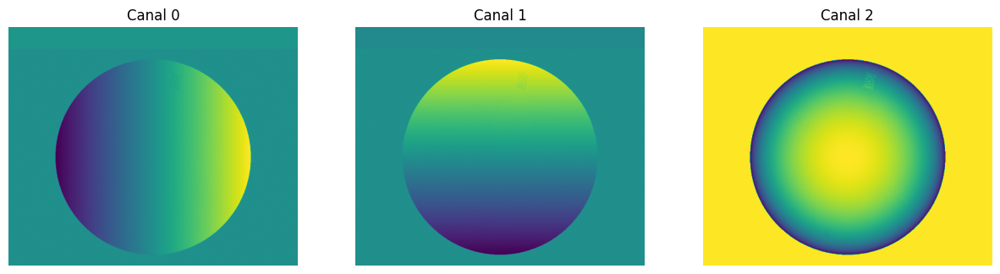

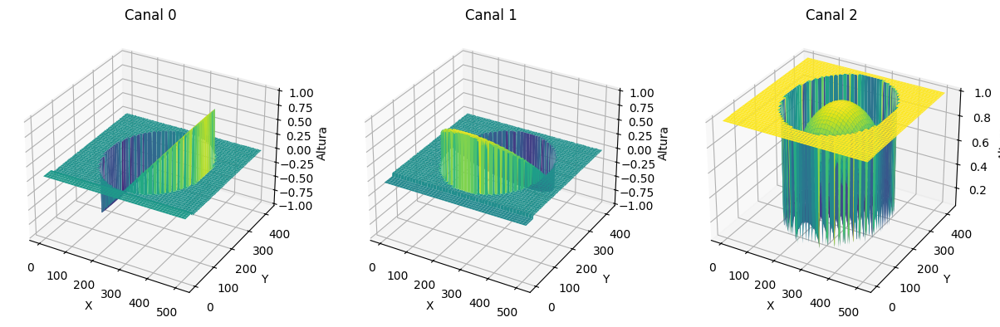

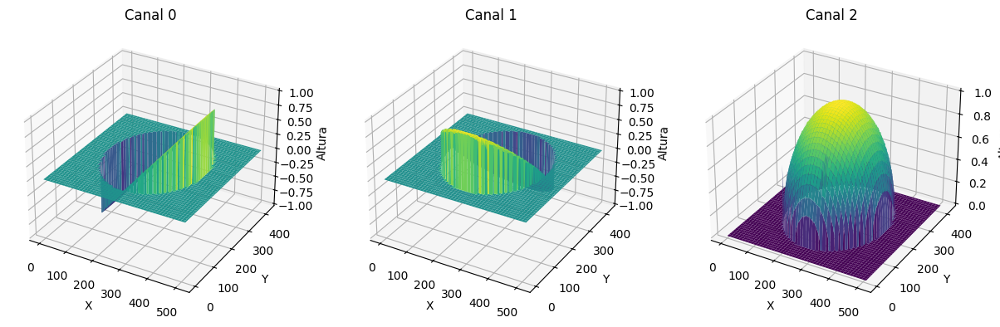

In [12]:
def estimate_normals_argmax(images, light_sources):
    images = images + 1e-6  # Adiciona um pequeno valor para evitar divisão por zero
    
    h, w, num_images = images.shape
    normals = np.zeros((h, w, 3), dtype=np.float32)
    selected_areas = np.zeros((h, w, num_images), dtype=np.float32)

    for i in range(h):
        for j in range(w):
            pixel_values = images[i, j, :]
            #top_indices = np.argsort(pixel_values)[[11, 9, 7]]  
            top_indices = np.argsort(pixel_values)[-3:]
            #print(top_indices)  
            selected_values = pixel_values[top_indices]
            selected_lights = light_sources[top_indices, :]

            # Resolver o sistema linear I = L * N de forma direta
            normal = np.dot(np.linalg.inv(selected_lights), selected_values)
            #normal = np.matmul(np.linalg.inv(selected_lights), selected_values)

            # Normalizar a normal
            normal /= np.linalg.norm(normal)
            normals[i, j, :] = normal

            selected_areas[i, j, top_indices] = 255
            
            if 137 < i < 139 and 85 < j < 87:
                print(f'Pixel: {i}, {j}')
                print(f'Pixel values: {pixel_values}')
                print(f'Top indices: {top_indices}')
                print(f'Selected images: {selected_values}')
                print(f'Selected lights: {selected_lights}')
                print(f'Normal: {normal}')
                print('\n ----------------- \n')
            
            if (list(top_indices) == [8, 7, 2]) and (55 < i < 200) and  (55 < j < 200):
                print(f'Pixel: {i}, {j}')
                print(f'Pixel values: {pixel_values}')
                print(f'Top indices: {top_indices}')
                print(f'Selected images: {selected_values}')
                print(f'Selected lights: {selected_lights}')
                print(f'Normal: {normal}')
                print('\n ----------------- \n')


    return normals, selected_areas


normals, selected_areas = estimate_normals_argmax(images, light_sources)

plotar_canais(normals)
plotar_canais_3d(normals)
normal_with_mask = normals * mask[:, :, np.newaxis]
plotar_canais_3d(normal_with_mask)





True

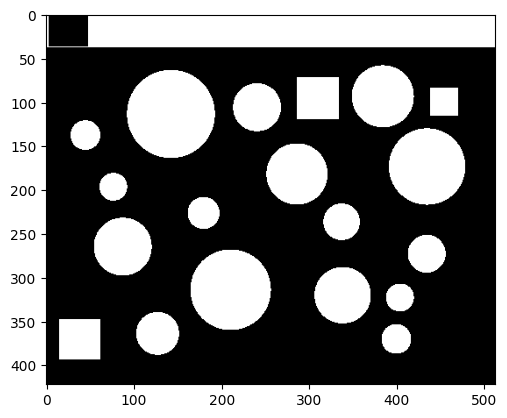

In [14]:
img_to_mask = cv2.imread('/home/lelis/Documents/Projetos/hybrid-stereo-method/data/raw/hybrid_stereo/2025-02-09-stF-melon24-amb0-glo0/stF-melon24/0512x0384-hs01-kr10/L000-amb0.00-glo0.00/sharp/hAvg.png', cv2.IMREAD_GRAYSCALE)
_, img_to_mask_bin = cv2.threshold(img_to_mask, 1, 255, cv2.THRESH_BINARY)
plt.imshow(img_to_mask_bin, cmap='gray')

cv2.imwrite('/home/lelis/Documents/Projetos/hybrid-stereo-method/data/raw/hybrid_stereo/2025-02-09-stF-melon24-amb0-glo0/mask.png', img_to_mask_bin)

In [17]:
path = '/home/lelis/Documents/Projetos/hybrid-stereo-method/data/raw/hybrid_stereo/2025-02-09-stF-melon24-amb0-glo0/images/'
image_paths = listar_arquivos(path)

light_path = '/home/lelis/Documents/Projetos/hybrid-stereo-method/data/raw/hybrid_stereo/2025-02-09-stF-melon24-amb0-glo0/lights.npy'
light_sources = np.load(light_path)


mask_path = '/home/lelis/Documents/Projetos/hybrid-stereo-method/data/raw/hybrid_stereo/2025-02-09-stF-melon24-amb0-glo0/mask.png'
mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE) / 255.0

images, light_sources = load_images_and_light_sources(image_paths, light_sources)

Pixel: 120, 105
Pixel values: [7.8441380e-03 1.0980492e-01 1.8039316e-01 1.4117748e-01 3.1373549e-02
 1.0000000e-06 1.0000000e-06 1.4902061e-01 1.4509904e-01 7.4510805e-02
 1.0000000e-06 1.0000000e-06]
Top indices: [8 7 2]
Selected images: [0.14509904 0.14902061 0.18039316]
Selected lights: [[-0.982  0.105  0.155]
 [-0.854 -0.484  0.19 ]
 [-0.708 -0.226  0.668]]
Normal: [-0.72736615 -0.15512832  0.66848612]

 ----------------- 

Pixel: 120, 106
Pixel values: [1.1765706e-02 1.0980492e-01 1.7255002e-01 1.3725591e-01 3.5295118e-02
 1.0000000e-06 1.0000000e-06 1.4117748e-01 1.3725591e-01 7.0589237e-02
 1.0000000e-06 1.0000000e-06]
Top indices: [8 7 2]
Selected images: [0.1372559  0.14117748 0.17255002]
Selected lights: [[-0.982  0.105  0.155]
 [-0.854 -0.484  0.19 ]
 [-0.708 -0.226  0.668]]
Normal: [-0.71621961 -0.15364779  0.68075093]

 ----------------- 

Pixel: 121, 105
Pixel values: [1.5687276e-02 1.7647159e-01 2.7843240e-01 2.1568727e-01 4.7059823e-02
 1.0000000e-06 1.0000000e-06 2.31

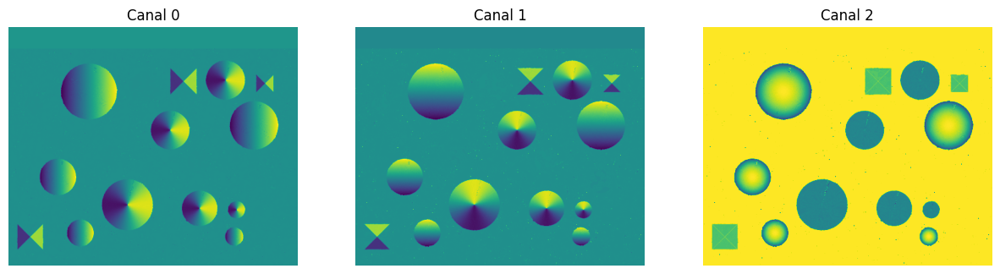

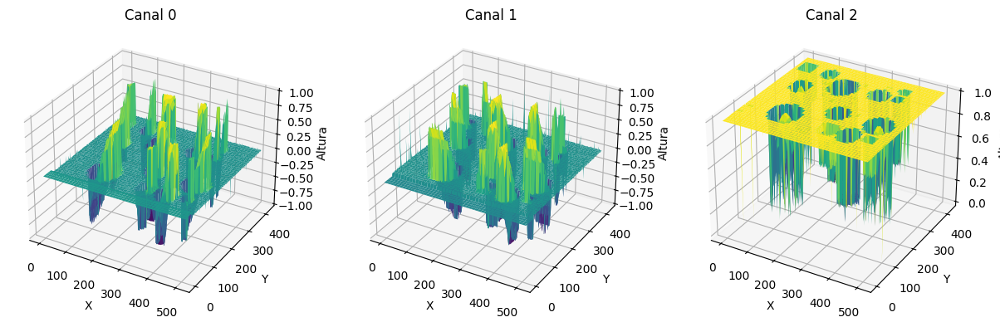

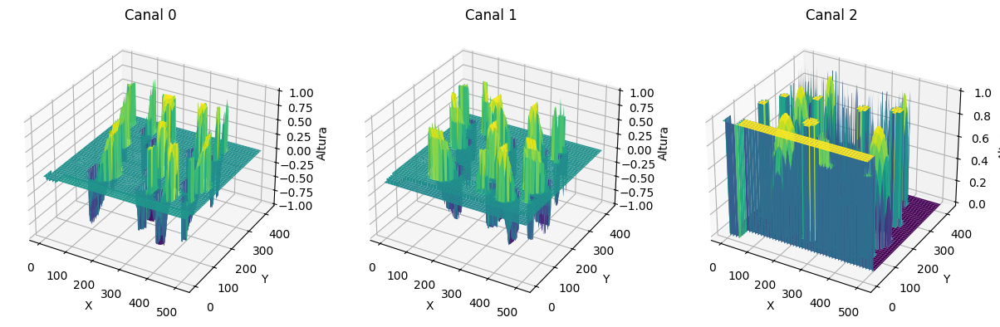

In [18]:
def estimate_normals_argmax(images, light_sources):
    images = images + 1e-6  # Adiciona um pequeno valor para evitar divisão por zero
    
    h, w, num_images = images.shape
    normals = np.zeros((h, w, 3), dtype=np.float32)
    selected_areas = np.zeros((h, w, num_images), dtype=np.float32)

    for i in range(h):
        for j in range(w):
            pixel_values = images[i, j, :]
            #top_indices = np.argsort(pixel_values)[[11, 9, 7]]  
            top_indices = np.argsort(pixel_values)[-3:]
            #print(top_indices)  
            selected_values = pixel_values[top_indices]
            selected_lights = light_sources[top_indices, :]

            # Resolver o sistema linear I = L * N de forma direta
            normal = np.dot(np.linalg.inv(selected_lights), selected_values)
            #normal = np.matmul(np.linalg.inv(selected_lights), selected_values)

            # Normalizar a normal
            normal /= np.linalg.norm(normal)
            normals[i, j, :] = normal

            selected_areas[i, j, top_indices] = 255
            
            if 137 < i < 139 and 85 < j < 87:
                print(f'Pixel: {i}, {j}')
                print(f'Pixel values: {pixel_values}')
                print(f'Top indices: {top_indices}')
                print(f'Selected images: {selected_values}')
                print(f'Selected lights: {selected_lights}')
                print(f'Normal: {normal}')
                print('\n ----------------- \n')
            
            if (list(top_indices) == [8, 7, 2]) and (55 < i < 200) and  (55 < j < 200):
                print(f'Pixel: {i}, {j}')
                print(f'Pixel values: {pixel_values}')
                print(f'Top indices: {top_indices}')
                print(f'Selected images: {selected_values}')
                print(f'Selected lights: {selected_lights}')
                print(f'Normal: {normal}')
                print('\n ----------------- \n')


    return normals, selected_areas


normals, selected_areas = estimate_normals_argmax(images, light_sources)

plotar_canais(normals)
plotar_canais_3d(normals)
normal_with_mask = normals * mask[:, :, np.newaxis]
plotar_canais_3d(normal_with_mask)





True

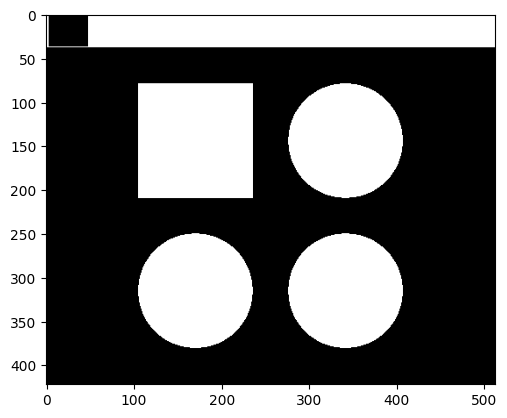

In [19]:
img_to_mask = cv2.imread('/home/lelis/Documents/Projetos/hybrid-stereo-method/data/raw/hybrid_stereo/2025-02-10-stQ-melon24-amb0.25-glo0.50/stQ-melon24/0512x0384-hs01-kr10/L000-amb0.25-glo0.50/sharp/hAvg.png', cv2.IMREAD_GRAYSCALE)
_, img_to_mask_bin = cv2.threshold(img_to_mask, 1, 255, cv2.THRESH_BINARY)
plt.imshow(img_to_mask_bin, cmap='gray')

cv2.imwrite('/home/lelis/Documents/Projetos/hybrid-stereo-method/data/raw/hybrid_stereo/2025-02-10-stQ-melon24-amb0.25-glo0.50/mask.png', img_to_mask_bin)

In [25]:
def normal_to_height(normal_map, scale=1.0):
    """
    Converte um mapa de normal em um mapa de altura.
    :param normal_map: Mapa de normal no intervalo [-1, 1]
    :param scale: Fator de escala para os gradientes.
    :return: Mapa de altura.
    """
    # Extrai as componentes x, y e z
    nx = normal_map[:, :, 0] #* 2 - 1  # Componente X (convertida para -1 a 1)
    ny = -normal_map[:, :, 1] #* 2 - 1  # Componente Y
    #nz = normal_map[:, :, 2] #* 2 - 1  # Componente Z (geralmente não usado para altura)

    # Inicializa o mapa de altura como uma matriz zerada
    height_map = np.zeros_like(nx, dtype=np.float32)
    
    # Integra os gradientes para calcular o mapa de altura
    for y in range(1, height_map.shape[0]):
        for x in range(1, height_map.shape[1]):
            height_map[y, x] = (
                height_map[y - 1, x] + ny[y, x] * scale +
                height_map[y, x - 1] + nx[y, x] * scale
            ) / 2  # Média entre os gradientes acumulados

    # Normaliza o mapa de altura para o intervalo [0, 1]
    min_val, max_val = np.min(height_map), np.max(height_map)
    print(f"Valores mínimos e máximos do mapa de altura: {min_val}, {max_val}")
    height_map = (height_map - min_val) / (max_val - min_val)

    return height_map

In [20]:
path = '/home/lelis/Documents/Projetos/hybrid-stereo-method/data/raw/hybrid_stereo/2025-02-10-stQ-melon24-amb0.25-glo0.50/images/'
image_paths = listar_arquivos(path)

light_path = '/home/lelis/Documents/Projetos/hybrid-stereo-method/data/raw/hybrid_stereo/2025-02-10-stQ-melon24-amb0.25-glo0.50/lights.npy'
light_sources = np.load(light_path)


mask_path = '/home/lelis/Documents/Projetos/hybrid-stereo-method/data/raw/hybrid_stereo/2025-02-10-stQ-melon24-amb0.25-glo0.50/mask.png'
mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE) / 255.0

images, light_sources = load_images_and_light_sources(image_paths, light_sources)

Pixel: 138, 86
Pixel values: [0.02745198 0.02745198 0.02745198 0.02745198 0.02745198 0.02745198
 0.01568728 0.01568728 0.01176571 0.01568728 0.01568728 0.01176571]
Top indices: [5 2 3]
Selected images: [0.02745198 0.02745198 0.02745198]
Selected lights: [[ 0.733  0.214  0.645]
 [-0.708 -0.226  0.668]
 [-0.563  0.499  0.658]]
Normal: [0.01251192 0.01128876 0.999858  ]

 ----------------- 

Informações estatísticas dos canais:
Canal 0:
  Mínimo: -0.999771773815155
  Máximo: 0.9998555183410645
  Média: -0.000660628080368042
  Desvio Padrão: 0.2654130458831787
Canal 1:
  Mínimo: -0.9904181361198425
  Máximo: 0.9827778339385986
  Média: -0.0015255598118528724
  Desvio Padrão: 0.2579749822616577
Canal 2:
  Mínimo: -0.6455322504043579
  Máximo: 0.9999997019767761
  Média: 0.9023924469947815
  Desvio Padrão: 0.2206575870513916


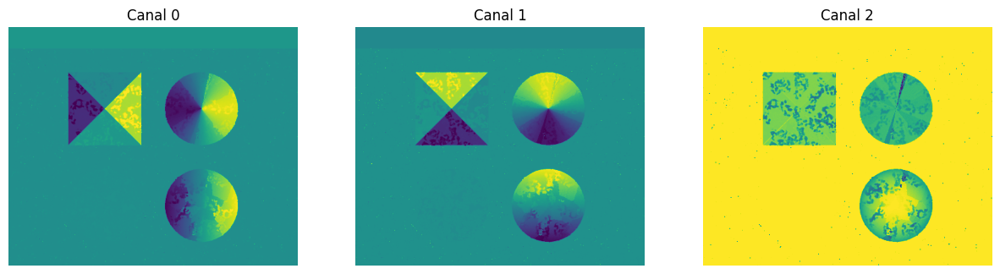

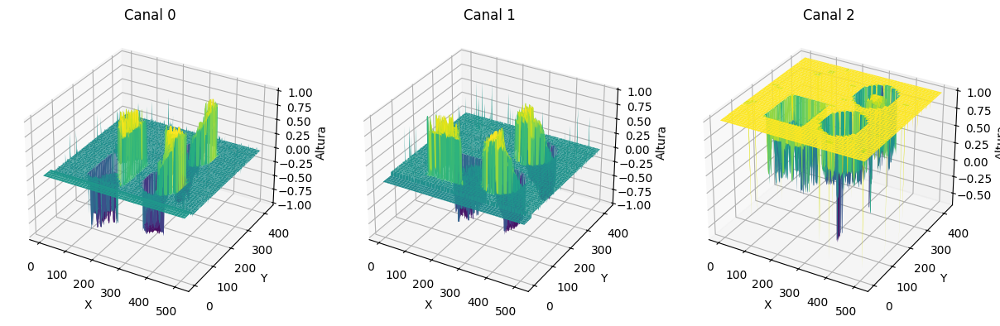

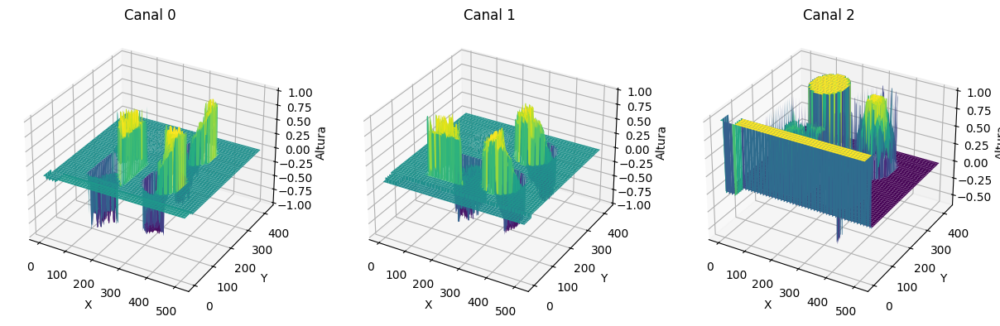

Valores mínimos e máximos do mapa de altura: -27.093820571899414, 4.508771896362305


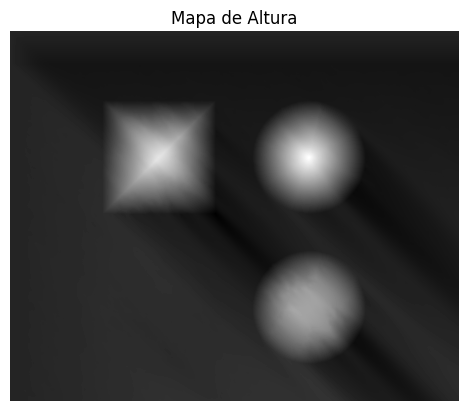

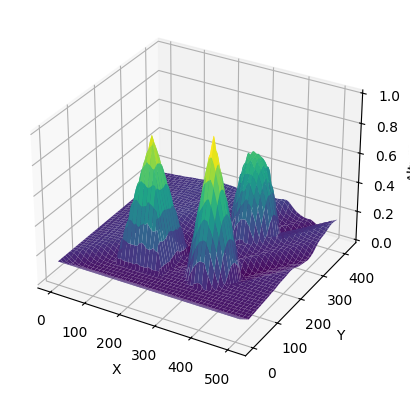

In [26]:
def estimate_normals_argmax(images, light_sources):
    images = images + 1e-6  # Adiciona um pequeno valor para evitar divisão por zero
    
    h, w, num_images = images.shape
    normals = np.zeros((h, w, 3), dtype=np.float32)
    selected_areas = np.zeros((h, w, num_images), dtype=np.float32)

    for i in range(h):
        for j in range(w):
            pixel_values = images[i, j, :]
            #top_indices = np.argsort(pixel_values)[[11, 9, 7]]  
            top_indices = np.argsort(pixel_values)[-3:]
            #print(top_indices)  
            selected_values = pixel_values[top_indices]
            selected_lights = light_sources[top_indices, :]

            # Resolver o sistema linear I = L * N de forma direta
            normal = np.dot(np.linalg.inv(selected_lights), selected_values)
            #normal = np.matmul(np.linalg.inv(selected_lights), selected_values)

            # Normalizar a normal
            normal /= np.linalg.norm(normal)
            normals[i, j, :] = normal

            selected_areas[i, j, top_indices] = 255
            
            if 137 < i < 139 and 85 < j < 87:
                print(f'Pixel: {i}, {j}')
                print(f'Pixel values: {pixel_values}')
                print(f'Top indices: {top_indices}')
                print(f'Selected images: {selected_values}')
                print(f'Selected lights: {selected_lights}')
                print(f'Normal: {normal}')
                print('\n ----------------- \n')
            
            if (list(top_indices) == [8, 7, 2]) and (55 < i < 200) and  (55 < j < 200):
                print(f'Pixel: {i}, {j}')
                print(f'Pixel values: {pixel_values}')
                print(f'Top indices: {top_indices}')
                print(f'Selected images: {selected_values}')
                print(f'Selected lights: {selected_lights}')
                print(f'Normal: {normal}')
                print('\n ----------------- \n')


    return normals, selected_areas


normals, selected_areas = estimate_normals_argmax(images, light_sources)

plotar_canais(normals)
plotar_canais_3d(normals)
normal_with_mask = normals * mask[:, :, np.newaxis]
plotar_canais_3d(normal_with_mask)

# Converte para mapa de altura
height_map = normal_to_height(normals, scale=0.5)
height_map = 1 - height_map/height_map.max()
#height_map = height_map * mascara

# Salva e exibe o resultado
height_map_output = (height_map * 255).astype(np.uint8)
#cv2.imwrite("height_map_corrected.png", height_map_output)
plt.imshow(height_map, cmap="gray")
plt.title("Mapa de Altura")
plt.axis("off")
plt.show()


plotar_mapa_altura_3d(height_map)




In [3]:
path = '/home/lelis/Documents/Projetos/hybrid-stereo-method/data/raw/hybrid_stereo/2025-02-09-stF-melon24-amb0-glo0/images/'
image_paths = listar_arquivos(path)

light_path = '/home/lelis/Documents/Projetos/hybrid-stereo-method/data/raw/hybrid_stereo/2025-02-09-stF-melon24-amb0-glo0/lights.npy'
light_sources = np.load(light_path)


mask_path = '/home/lelis/Documents/Projetos/hybrid-stereo-method/data/raw/hybrid_stereo/2025-02-09-stF-melon24-amb0-glo0/mask.png'
mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE) / 255.0

images, light_sources = load_images_and_light_sources(image_paths, light_sources)

Pixel: 120, 105
Pixel values: [7.8441380e-03 1.0980492e-01 1.8039316e-01 1.4117748e-01 3.1373549e-02
 1.0000000e-06 1.0000000e-06 1.4902061e-01 1.4509904e-01 7.4510805e-02
 1.0000000e-06 1.0000000e-06]
Top indices: [8 7 2]
Selected images: [0.14509904 0.14902061 0.18039316]
Selected lights: [[-0.982  0.105  0.155]
 [-0.854 -0.484  0.19 ]
 [-0.708 -0.226  0.668]]
Normal: [-0.72736615 -0.15512832  0.66848612]

 ----------------- 

Pixel: 120, 106
Pixel values: [1.1765706e-02 1.0980492e-01 1.7255002e-01 1.3725591e-01 3.5295118e-02
 1.0000000e-06 1.0000000e-06 1.4117748e-01 1.3725591e-01 7.0589237e-02
 1.0000000e-06 1.0000000e-06]
Top indices: [8 7 2]
Selected images: [0.1372559  0.14117748 0.17255002]
Selected lights: [[-0.982  0.105  0.155]
 [-0.854 -0.484  0.19 ]
 [-0.708 -0.226  0.668]]
Normal: [-0.71621961 -0.15364779  0.68075093]

 ----------------- 

Pixel: 121, 105
Pixel values: [1.5687276e-02 1.7647159e-01 2.7843240e-01 2.1568727e-01 4.7059823e-02
 1.0000000e-06 1.0000000e-06 2.31

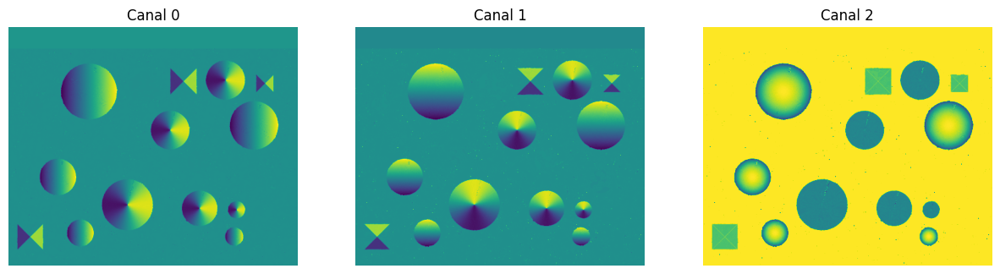

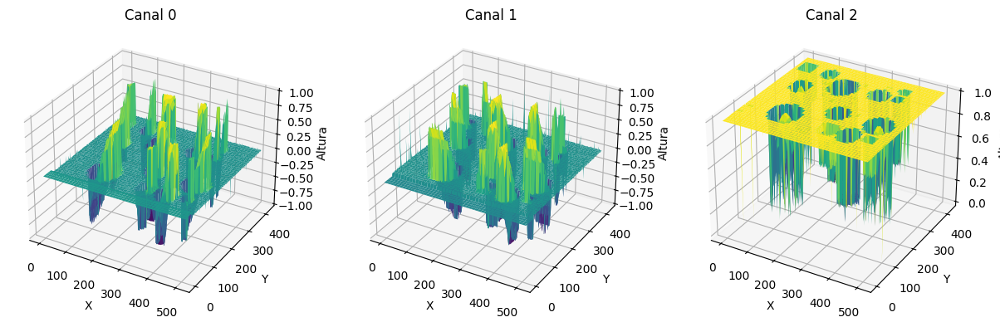

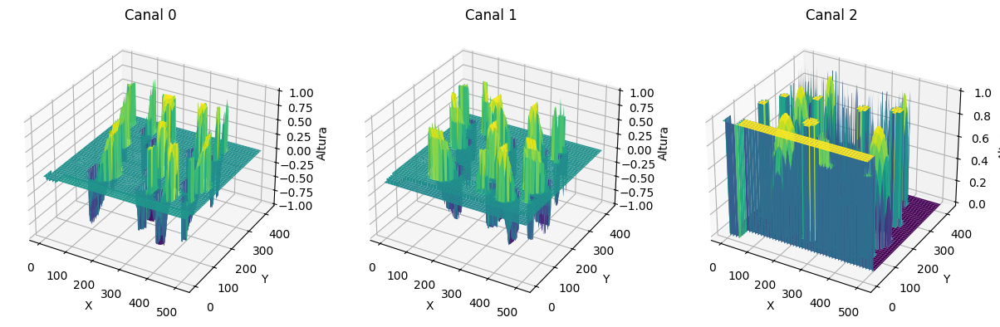

NameError: name 'normal_to_height' is not defined

In [4]:
def estimate_normals_argmax(images, light_sources):
    images = images + 1e-6  # Adiciona um pequeno valor para evitar divisão por zero
    
    h, w, num_images = images.shape
    normals = np.zeros((h, w, 3), dtype=np.float32)
    selected_areas = np.zeros((h, w, num_images), dtype=np.float32)

    for i in range(h):
        for j in range(w):
            pixel_values = images[i, j, :]
            #top_indices = np.argsort(pixel_values)[[11, 9, 7]]  
            top_indices = np.argsort(pixel_values)[-3:]
            #print(top_indices)  
            selected_values = pixel_values[top_indices]
            selected_lights = light_sources[top_indices, :]

            # Resolver o sistema linear I = L * N de forma direta
            normal = np.dot(np.linalg.inv(selected_lights), selected_values)
            #normal = np.matmul(np.linalg.inv(selected_lights), selected_values)

            # Normalizar a normal
            normal /= np.linalg.norm(normal)
            normals[i, j, :] = normal

            selected_areas[i, j, top_indices] = 255
            
            if 137 < i < 139 and 85 < j < 87:
                print(f'Pixel: {i}, {j}')
                print(f'Pixel values: {pixel_values}')
                print(f'Top indices: {top_indices}')
                print(f'Selected images: {selected_values}')
                print(f'Selected lights: {selected_lights}')
                print(f'Normal: {normal}')
                print('\n ----------------- \n')
            
            if (list(top_indices) == [8, 7, 2]) and (55 < i < 200) and  (55 < j < 200):
                print(f'Pixel: {i}, {j}')
                print(f'Pixel values: {pixel_values}')
                print(f'Top indices: {top_indices}')
                print(f'Selected images: {selected_values}')
                print(f'Selected lights: {selected_lights}')
                print(f'Normal: {normal}')
                print('\n ----------------- \n')


    return normals, selected_areas


normals, selected_areas = estimate_normals_argmax(images, light_sources)

plotar_canais(normals)
plotar_canais_3d(normals)
normal_with_mask = normals * mask[:, :, np.newaxis]
plotar_canais_3d(normal_with_mask)

# Converte para mapa de altura
height_map = normal_to_height(normals, scale=0.5)
height_map = 1 - height_map/height_map.max()
#height_map = height_map * mascara

# Salva e exibe o resultado
height_map_output = (height_map * 255).astype(np.uint8)
#cv2.imwrite("height_map_corrected.png", height_map_output)
plt.imshow(height_map, cmap="gray")
plt.title("Mapa de Altura")
plt.axis("off")
plt.show()


plotar_mapa_altura_3d(height_map)


